In [1]:
import tensorflow as tf
from tensorflow.keras import models, layers
import matplotlib.pyplot as plt
from IPython.display import HTML

In [2]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Dense, Activation, Flatten, BatchNormalization, Conv2D, MaxPool2D,Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model
from tensorflow.keras.applications import imagenet_utils
from sklearn.metrics import confusion_matrix
from tensorflow.keras.optimizers import Adam
import itertools
import os
import shutil
import random
import matplotlib.pyplot as plt
%matplotlib inline
from tensorflow.keras.models import Sequential

import cv2

In [3]:
!pip install split-folders

In [4]:
import splitfolders

In [5]:
import splitfolders


input_folder = r"C:\Users\Sameera maduSanka\Downloads\sam MobileNet\copy" 
output_folder = r"C:\Users\Sameera maduSanka\Downloads\sam MobileNet\dataSet"


splitfolders.ratio(input_folder, output=output_folder, seed=42, ratio=(0.8, 0.1, 0.1))

Copying files: 1471 files [00:13, 108.11 files/s]


In [6]:
train_ds = 'dataSet/train'
valid_ds = 'dataSet/val'
test_ds = 'dataSet/test'

In [7]:
train_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input).flow_from_directory(
    directory=train_ds, target_size=(224,224), batch_size=10)
valid_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input).flow_from_directory(
    directory=valid_ds, target_size=(224,224), batch_size=10)
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input).flow_from_directory(
    directory=test_ds, target_size=(224,224), batch_size=10, shuffle=False)

Found 1173 images belonging to 6 classes.
Found 144 images belonging to 6 classes.
Found 153 images belonging to 6 classes.


In [8]:
import tensorflow as tf

mobile_net_v2 = tf.keras.applications.MobileNetV2()

In [9]:
mobile_net_v2.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_1[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[

 block_3_expand_relu (ReLU)  (None, 56, 56, 144)          0         ['block_3_expand_BN[0][0]']   
                                                                                                  
 block_3_pad (ZeroPadding2D  (None, 57, 57, 144)          0         ['block_3_expand_relu[0][0]'] 
 )                                                                                                
                                                                                                  
 block_3_depthwise (Depthwi  (None, 28, 28, 144)          1296      ['block_3_pad[0][0]']         
 seConv2D)                                                                                        
                                                                                                  
 block_3_depthwise_BN (Batc  (None, 28, 28, 144)          576       ['block_3_depthwise[0][0]']   
 hNormalization)                                                                                  
          

 block_6_depthwise_BN (Batc  (None, 14, 14, 192)          768       ['block_6_depthwise[0][0]']   
 hNormalization)                                                                                  
                                                                                                  
 block_6_depthwise_relu (Re  (None, 14, 14, 192)          0         ['block_6_depthwise_BN[0][0]']
 LU)                                                                                              
                                                                                                  
 block_6_project (Conv2D)    (None, 14, 14, 64)           12288     ['block_6_depthwise_relu[0][0]
                                                                    ']                            
                                                                                                  
 block_6_project_BN (BatchN  (None, 14, 14, 64)           256       ['block_6_project[0][0]']     
 ormalizat

                                                                                                  
 block_9_add (Add)           (None, 14, 14, 64)           0         ['block_8_add[0][0]',         
                                                                     'block_9_project_BN[0][0]']  
                                                                                                  
 block_10_expand (Conv2D)    (None, 14, 14, 384)          24576     ['block_9_add[0][0]']         
                                                                                                  
 block_10_expand_BN (BatchN  (None, 14, 14, 384)          1536      ['block_10_expand[0][0]']     
 ormalization)                                                                                    
                                                                                                  
 block_10_expand_relu (ReLU  (None, 14, 14, 384)          0         ['block_10_expand_BN[0][0]']  
 )        

                                                                                                  
 block_13_expand_relu (ReLU  (None, 14, 14, 576)          0         ['block_13_expand_BN[0][0]']  
 )                                                                                                
                                                                                                  
 block_13_pad (ZeroPadding2  (None, 15, 15, 576)          0         ['block_13_expand_relu[0][0]']
 D)                                                                                               
                                                                                                  
 block_13_depthwise (Depthw  (None, 7, 7, 576)            5184      ['block_13_pad[0][0]']        
 iseConv2D)                                                                                       
                                                                                                  
 block_13_

 iseConv2D)                                                                                       
                                                                                                  
 block_16_depthwise_BN (Bat  (None, 7, 7, 960)            3840      ['block_16_depthwise[0][0]']  
 chNormalization)                                                                                 
                                                                                                  
 block_16_depthwise_relu (R  (None, 7, 7, 960)            0         ['block_16_depthwise_BN[0][0]'
 eLU)                                                               ]                             
                                                                                                  
 block_16_project (Conv2D)   (None, 7, 7, 320)            307200    ['block_16_depthwise_relu[0][0
                                                                    ]']                           
          

In [10]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
mobile_net_v2 = MobileNetV2(weights='imagenet', include_top=True)


new_model = tf.keras.Model(inputs=mobile_net_v2.input, outputs=mobile_net_v2.layers[-2].output)


new_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_2[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[0][0]']        

 block_3_expand_relu (ReLU)  (None, 56, 56, 144)          0         ['block_3_expand_BN[0][0]']   
                                                                                                  
 block_3_pad (ZeroPadding2D  (None, 57, 57, 144)          0         ['block_3_expand_relu[0][0]'] 
 )                                                                                                
                                                                                                  
 block_3_depthwise (Depthwi  (None, 28, 28, 144)          1296      ['block_3_pad[0][0]']         
 seConv2D)                                                                                        
                                                                                                  
 block_3_depthwise_BN (Batc  (None, 28, 28, 144)          576       ['block_3_depthwise[0][0]']   
 hNormalization)                                                                                  
          

 block_6_depthwise_BN (Batc  (None, 14, 14, 192)          768       ['block_6_depthwise[0][0]']   
 hNormalization)                                                                                  
                                                                                                  
 block_6_depthwise_relu (Re  (None, 14, 14, 192)          0         ['block_6_depthwise_BN[0][0]']
 LU)                                                                                              
                                                                                                  
 block_6_project (Conv2D)    (None, 14, 14, 64)           12288     ['block_6_depthwise_relu[0][0]
                                                                    ']                            
                                                                                                  
 block_6_project_BN (BatchN  (None, 14, 14, 64)           256       ['block_6_project[0][0]']     
 ormalizat

                                                                                                  
 block_9_add (Add)           (None, 14, 14, 64)           0         ['block_8_add[0][0]',         
                                                                     'block_9_project_BN[0][0]']  
                                                                                                  
 block_10_expand (Conv2D)    (None, 14, 14, 384)          24576     ['block_9_add[0][0]']         
                                                                                                  
 block_10_expand_BN (BatchN  (None, 14, 14, 384)          1536      ['block_10_expand[0][0]']     
 ormalization)                                                                                    
                                                                                                  
 block_10_expand_relu (ReLU  (None, 14, 14, 384)          0         ['block_10_expand_BN[0][0]']  
 )        

                                                                                                  
 block_13_expand_relu (ReLU  (None, 14, 14, 576)          0         ['block_13_expand_BN[0][0]']  
 )                                                                                                
                                                                                                  
 block_13_pad (ZeroPadding2  (None, 15, 15, 576)          0         ['block_13_expand_relu[0][0]']
 D)                                                                                               
                                                                                                  
 block_13_depthwise (Depthw  (None, 7, 7, 576)            5184      ['block_13_pad[0][0]']        
 iseConv2D)                                                                                       
                                                                                                  
 block_13_

 iseConv2D)                                                                                       
                                                                                                  
 block_16_depthwise_BN (Bat  (None, 7, 7, 960)            3840      ['block_16_depthwise[0][0]']  
 chNormalization)                                                                                 
                                                                                                  
 block_16_depthwise_relu (R  (None, 7, 7, 960)            0         ['block_16_depthwise_BN[0][0]'
 eLU)                                                               ]                             
                                                                                                  
 block_16_project (Conv2D)   (None, 7, 7, 320)            307200    ['block_16_depthwise_relu[0][0
                                                                    ]']                           
          

In [11]:
num_classes = 6
new_last_layer = tf.keras.layers.Dense(num_classes, activation='softmax')(new_model.output)

# Create the final model with the new last layer
final_model = tf.keras.Model(inputs=new_model.input, outputs=new_last_layer)

# Print the summary of the final model
final_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_2[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[0][0]']      

 block_3_expand_relu (ReLU)  (None, 56, 56, 144)          0         ['block_3_expand_BN[0][0]']   
                                                                                                  
 block_3_pad (ZeroPadding2D  (None, 57, 57, 144)          0         ['block_3_expand_relu[0][0]'] 
 )                                                                                                
                                                                                                  
 block_3_depthwise (Depthwi  (None, 28, 28, 144)          1296      ['block_3_pad[0][0]']         
 seConv2D)                                                                                        
                                                                                                  
 block_3_depthwise_BN (Batc  (None, 28, 28, 144)          576       ['block_3_depthwise[0][0]']   
 hNormalization)                                                                                  
          

 block_6_depthwise_BN (Batc  (None, 14, 14, 192)          768       ['block_6_depthwise[0][0]']   
 hNormalization)                                                                                  
                                                                                                  
 block_6_depthwise_relu (Re  (None, 14, 14, 192)          0         ['block_6_depthwise_BN[0][0]']
 LU)                                                                                              
                                                                                                  
 block_6_project (Conv2D)    (None, 14, 14, 64)           12288     ['block_6_depthwise_relu[0][0]
                                                                    ']                            
                                                                                                  
 block_6_project_BN (BatchN  (None, 14, 14, 64)           256       ['block_6_project[0][0]']     
 ormalizat

                                                                                                  
 block_9_add (Add)           (None, 14, 14, 64)           0         ['block_8_add[0][0]',         
                                                                     'block_9_project_BN[0][0]']  
                                                                                                  
 block_10_expand (Conv2D)    (None, 14, 14, 384)          24576     ['block_9_add[0][0]']         
                                                                                                  
 block_10_expand_BN (BatchN  (None, 14, 14, 384)          1536      ['block_10_expand[0][0]']     
 ormalization)                                                                                    
                                                                                                  
 block_10_expand_relu (ReLU  (None, 14, 14, 384)          0         ['block_10_expand_BN[0][0]']  
 )        

                                                                                                  
 block_13_expand_relu (ReLU  (None, 14, 14, 576)          0         ['block_13_expand_BN[0][0]']  
 )                                                                                                
                                                                                                  
 block_13_pad (ZeroPadding2  (None, 15, 15, 576)          0         ['block_13_expand_relu[0][0]']
 D)                                                                                               
                                                                                                  
 block_13_depthwise (Depthw  (None, 7, 7, 576)            5184      ['block_13_pad[0][0]']        
 iseConv2D)                                                                                       
                                                                                                  
 block_13_

 iseConv2D)                                                                                       
                                                                                                  
 block_16_depthwise_BN (Bat  (None, 7, 7, 960)            3840      ['block_16_depthwise[0][0]']  
 chNormalization)                                                                                 
                                                                                                  
 block_16_depthwise_relu (R  (None, 7, 7, 960)            0         ['block_16_depthwise_BN[0][0]'
 eLU)                                                               ]                             
                                                                                                  
 block_16_project (Conv2D)   (None, 7, 7, 320)            307200    ['block_16_depthwise_relu[0][0
                                                                    ]']                           
          

In [12]:
final_model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [13]:
history=final_model.fit(x=train_batches,
            steps_per_epoch=len(train_batches),
            validation_data=valid_batches,
            validation_steps=len(valid_batches),
            epochs=10,
            verbose=2
)

Epoch 1/10
118/118 - 173s - loss: 0.4065 - accuracy: 0.8764 - val_loss: 0.2894 - val_accuracy: 0.9028 - 173s/epoch - 1s/step
Epoch 2/10
118/118 - 148s - loss: 0.0766 - accuracy: 0.9829 - val_loss: 0.4531 - val_accuracy: 0.8542 - 148s/epoch - 1s/step
Epoch 3/10
118/118 - 149s - loss: 0.0364 - accuracy: 0.9940 - val_loss: 0.2384 - val_accuracy: 0.9306 - 149s/epoch - 1s/step
Epoch 4/10
118/118 - 148s - loss: 0.0303 - accuracy: 0.9906 - val_loss: 0.0801 - val_accuracy: 0.9861 - 148s/epoch - 1s/step
Epoch 5/10
118/118 - 141s - loss: 0.0402 - accuracy: 0.9889 - val_loss: 0.1549 - val_accuracy: 0.9514 - 141s/epoch - 1s/step
Epoch 6/10
118/118 - 129s - loss: 0.0130 - accuracy: 0.9966 - val_loss: 0.1933 - val_accuracy: 0.9306 - 129s/epoch - 1s/step
Epoch 7/10
118/118 - 131s - loss: 0.0204 - accuracy: 0.9932 - val_loss: 0.2512 - val_accuracy: 0.9167 - 131s/epoch - 1s/step
Epoch 8/10
118/118 - 128s - loss: 0.0124 - accuracy: 0.9966 - val_loss: 0.1945 - val_accuracy: 0.9167 - 128s/epoch - 1s/step


In [14]:
import os.path
final_model.save('V1.0.h5')

D:\Appz\anaconda\lib\site-packages\keras\src\engine\training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [15]:
converter = tf.lite.TFLiteConverter.from_keras_model(final_model)
tflite_model = converter.convert()

# Define the complete path and filename for saving the model
tflite_model_path = "C:/Users/Sameera maduSanka/Downloads/sam MobileNet/TenserflowLite/final_model_new.tflite"

# Save the TensorFlow Lite model to the specified location
with open(tflite_model_path, 'wb') as f:
    f.write(tflite_model)

print(f"TensorFlow Lite model saved at: {tflite_model_path}")

INFO:tensorflow:Assets written to: C:\Users\SAMEER~1\AppData\Local\Temp\tmpzkjy8c5o\assets


INFO:tensorflow:Assets written to: C:\Users\SAMEER~1\AppData\Local\Temp\tmpzkjy8c5o\assets


TensorFlow Lite model saved at: C:/Users/Sameera maduSanka/Downloads/sam MobileNet/TenserflowLite/final_model_new.tflite


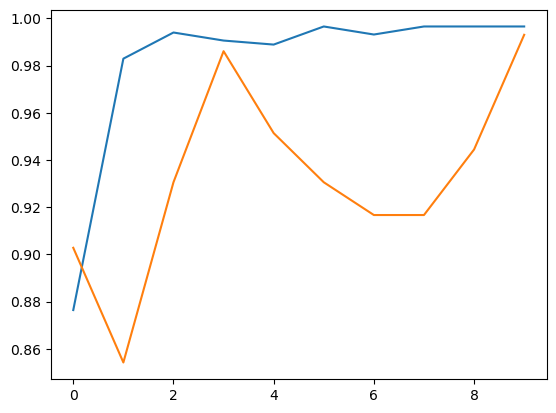

In [16]:
import matplotlib.pyplot as plt
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])

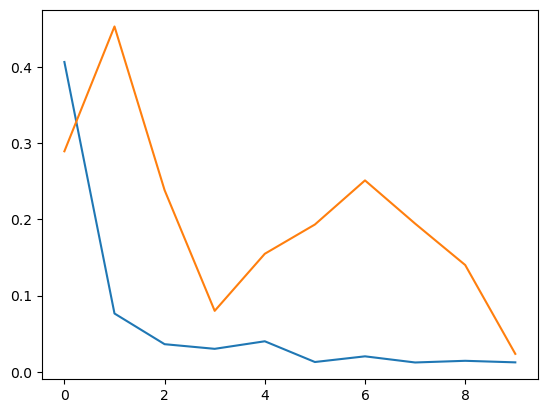

In [17]:
import matplotlib.pyplot as plt
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])

In [18]:
test_batches.class_indices

{'bulath hapaya': 0,
 'damkolapethiya': 1,
 'galpadiya': 2,
 'kawaiya': 3,
 'others': 4,
 'thalkossa (belontia signat )': 5}

In [19]:
test_labels = test_batches.classes

In [20]:
predictions = final_model.predict(x=test_batches, steps=len(test_batches), verbose=0)

In [21]:
predictions

array([[9.99998569e-01, 5.72927235e-08, 2.39414479e-08, 1.16393130e-06,
        3.74459387e-11, 2.06267075e-07],
       [9.99973774e-01, 2.45653573e-05, 1.24490327e-07, 1.50802850e-06,
        3.43658130e-10, 3.48514178e-08],
       [9.99999881e-01, 3.91434689e-08, 2.13653828e-09, 7.80564662e-08,
        4.91506879e-12, 1.26937785e-08],
       [9.99996781e-01, 1.46515745e-07, 1.79698972e-07, 2.88030469e-06,
        3.90474875e-10, 1.68416694e-08],
       [9.99999166e-01, 1.74691390e-08, 1.23852018e-07, 7.24600341e-07,
        2.16131939e-11, 1.77145720e-09],
       [9.99998212e-01, 7.66260584e-08, 8.06843232e-08, 1.57181853e-06,
        3.78590076e-11, 2.21135749e-10],
       [9.78926361e-01, 1.10951802e-02, 1.34123575e-05, 9.86415055e-03,
        9.49184396e-05, 5.90891932e-06],
       [9.99999285e-01, 1.75513591e-07, 1.89495211e-08, 4.91626395e-07,
        3.23217147e-11, 6.61236066e-10],
       [9.99996424e-01, 4.45111237e-09, 2.79516899e-09, 3.61705725e-06,
        2.50005378e-10, 

In [22]:
pip install opencv-python

In [23]:
# Assuming you have preprocessed your test data into 'test_batches' (similar to how you preprocessed your train and validation data)
# 'test_batches' should be an instance of ImageDataGenerator.flow_from_directory()

# Get predictions from the model
predictions = final_model.predict(test_batches)

# Convert predicted probabilities to class labels
predicted_labels = predictions.argmax(axis=-1)

# Get actual labels from the 'test_batches' object
actual_labels = test_batches.classes

# Get class names from the 'test_batches' object
class_names = list(test_batches.class_indices.keys())

# Iterate through the test batch and print image filename, predicted class name, and actual class name
for i in range(len(test_batches.filenames)):
    image_filename = test_batches.filenames[i]
    predicted_class_name = class_names[predicted_labels[i]]
    actual_class_name = class_names[actual_labels[i]]
    
    
    print(f"Image: {image_filename} | Predicted: {predicted_class_name} | Actual: {actual_class_name}")


16/16 [==============================] - 7s 387ms/step
Image: bulath hapaya\2023_06_19_10_50_IMG_0713.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_50_IMG_0714.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_50_IMG_0716.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_50_IMG_0746.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_50_IMG_0750.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_50_IMG_0773.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_50_IMG_0776.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_51_IMG_0788.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_06_19_10_51_IMG_0826.JPG | Predicted: bulath hapaya | Actual: bulath hapaya
Image: bulath hapaya\2023_0

16/16 [==============================] - 7s 390ms/step


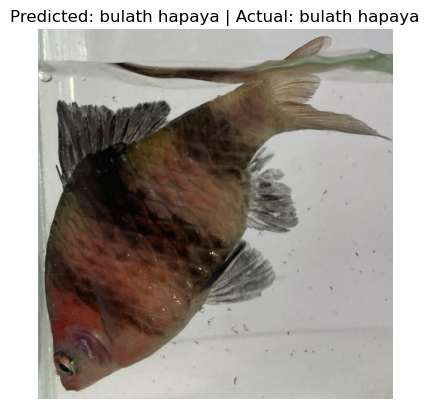

Image: bulath hapaya\2023_06_19_10_50_IMG_0713.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


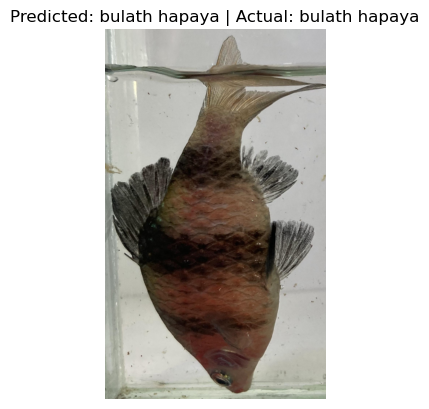

Image: bulath hapaya\2023_06_19_10_50_IMG_0714.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


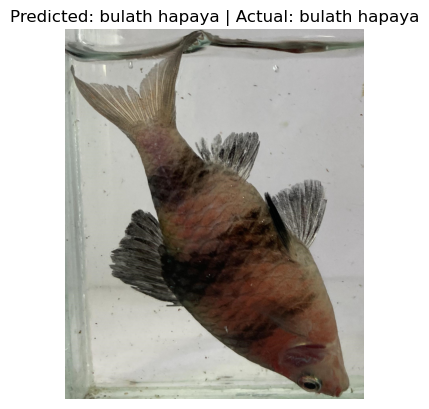

Image: bulath hapaya\2023_06_19_10_50_IMG_0716.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


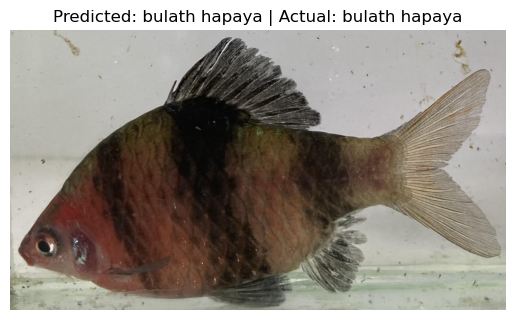

Image: bulath hapaya\2023_06_19_10_50_IMG_0746.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


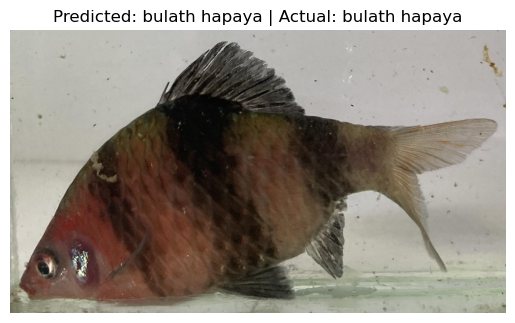

Image: bulath hapaya\2023_06_19_10_50_IMG_0750.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


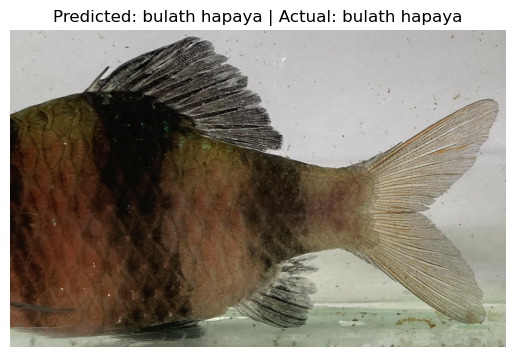

Image: bulath hapaya\2023_06_19_10_50_IMG_0773.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


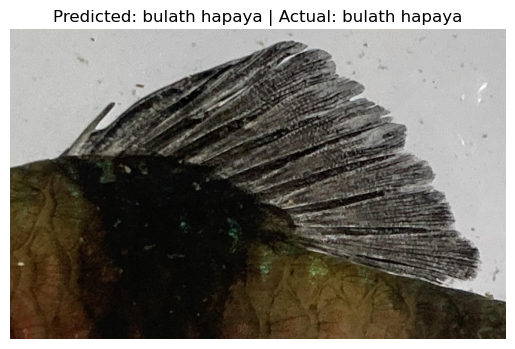

Image: bulath hapaya\2023_06_19_10_50_IMG_0776.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


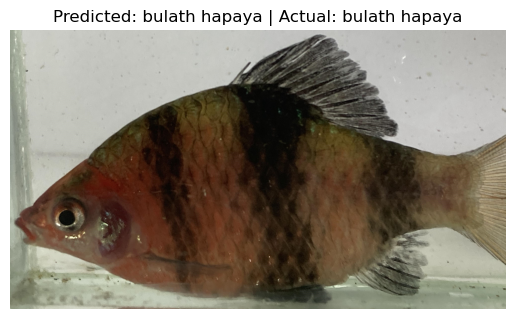

Image: bulath hapaya\2023_06_19_10_51_IMG_0788.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


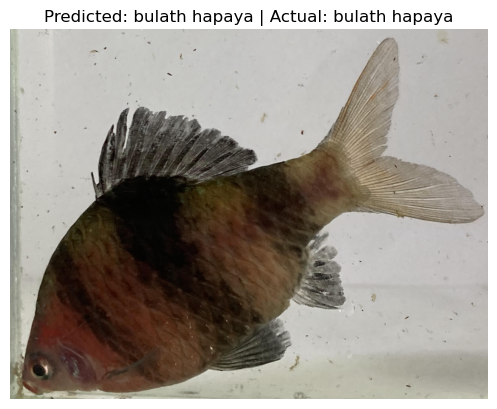

Image: bulath hapaya\2023_06_19_10_51_IMG_0826.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


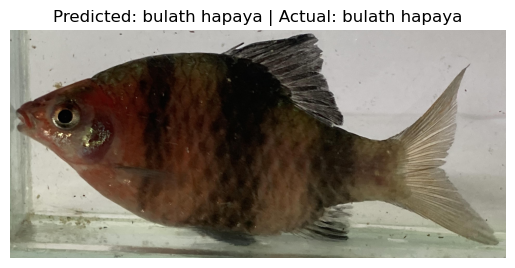

Image: bulath hapaya\2023_06_19_10_51_IMG_0828.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


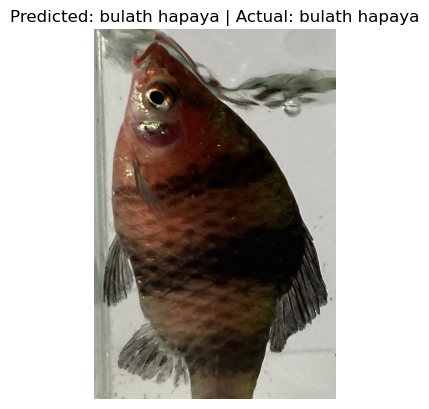

Image: bulath hapaya\2023_06_19_10_51_IMG_0830.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


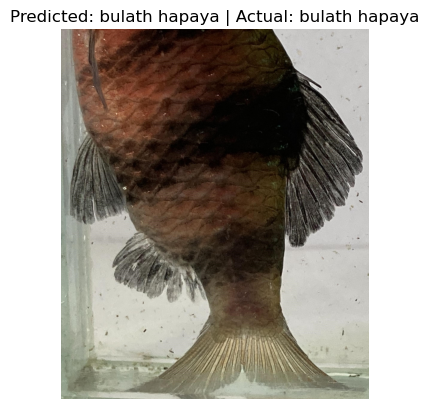

Image: bulath hapaya\2023_06_19_10_51_IMG_0833.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


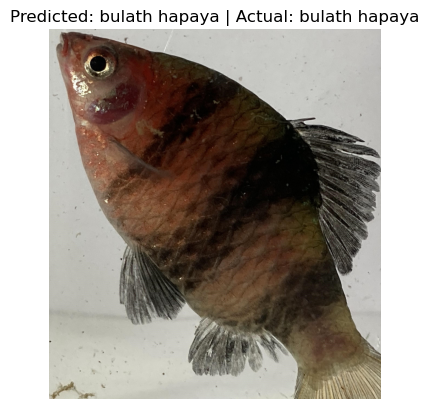

Image: bulath hapaya\2023_06_19_10_52_IMG_0845.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


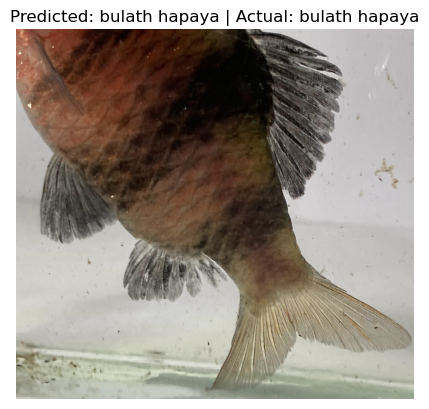

Image: bulath hapaya\2023_06_19_10_52_IMG_0885.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


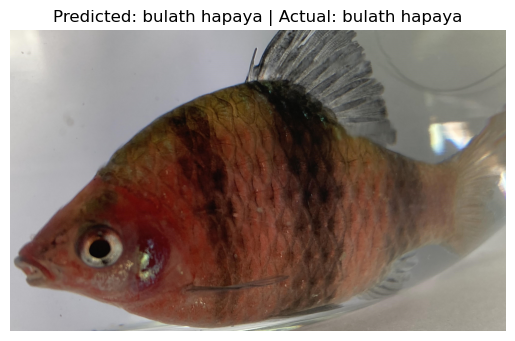

Image: bulath hapaya\2023_06_19_10_55_IMG_0917.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


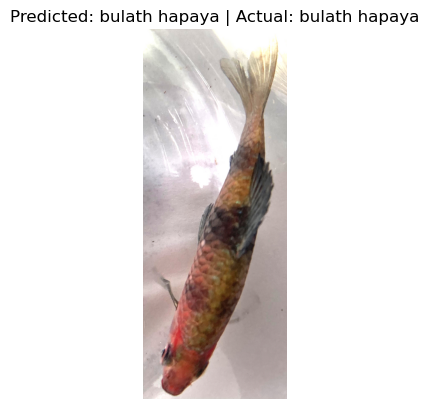

Image: bulath hapaya\2023_06_19_10_55_IMG_0933.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


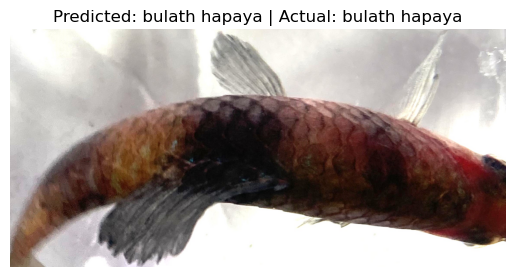

Image: bulath hapaya\2023_06_19_10_56_IMG_0946.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


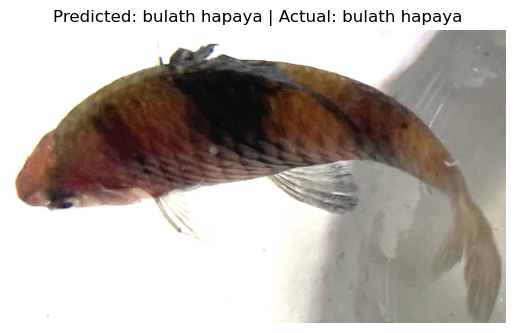

Image: bulath hapaya\2023_06_19_10_56_IMG_0952.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


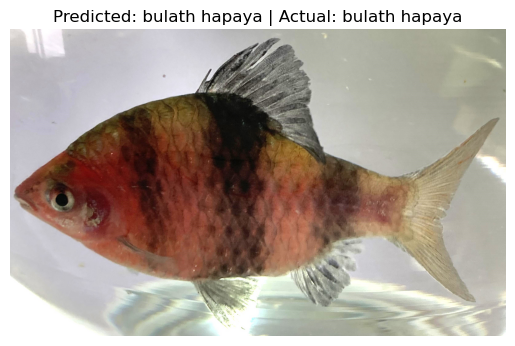

Image: bulath hapaya\2023_06_19_10_56_IMG_0964.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


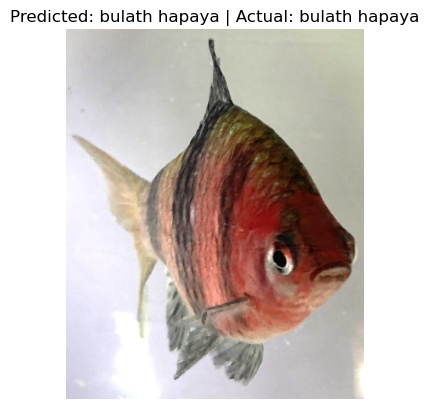

Image: bulath hapaya\2023_06_19_10_56_IMG_0977.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


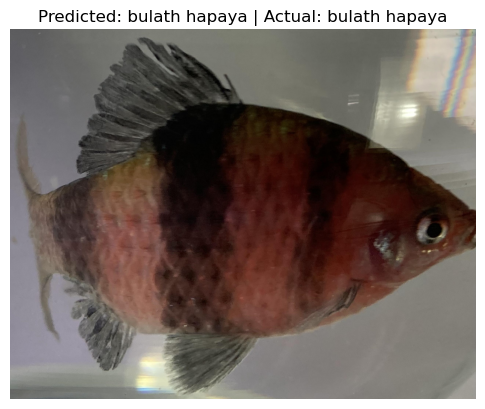

Image: bulath hapaya\2023_06_19_10_56_IMG_1003.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


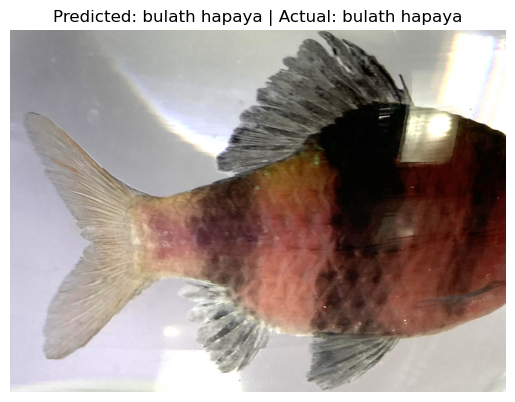

Image: bulath hapaya\2023_06_19_10_56_IMG_1004.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


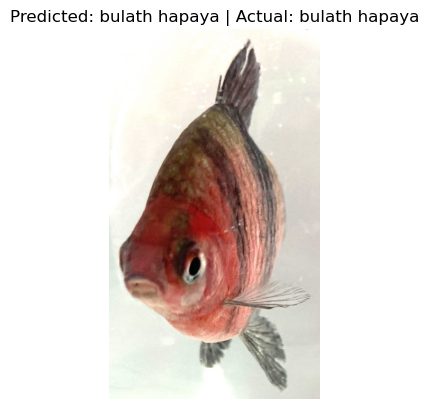

Image: bulath hapaya\2023_06_19_10_59_IMG_1112.JPG | Predicted: bulath hapaya | Actual: bulath hapaya


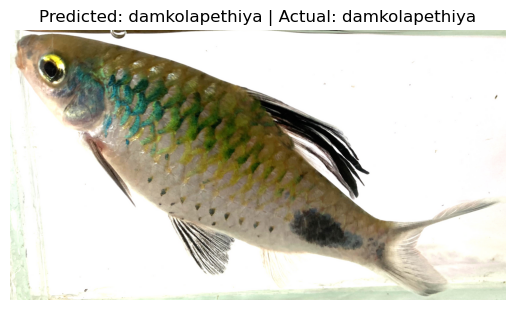

Image: damkolapethiya\2023_06_19_11_54_IMG_1768.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


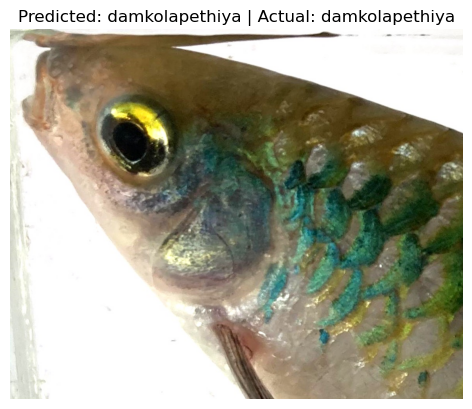

Image: damkolapethiya\2023_06_19_11_54_IMG_1769.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


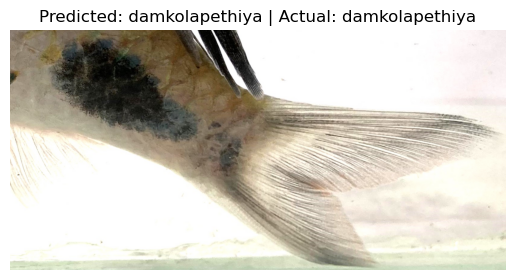

Image: damkolapethiya\2023_06_19_11_54_IMG_1771.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


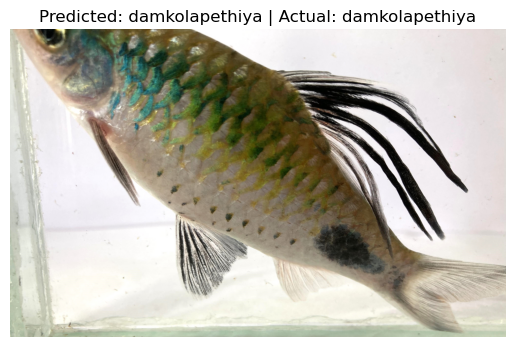

Image: damkolapethiya\2023_06_19_11_54_IMG_1788.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


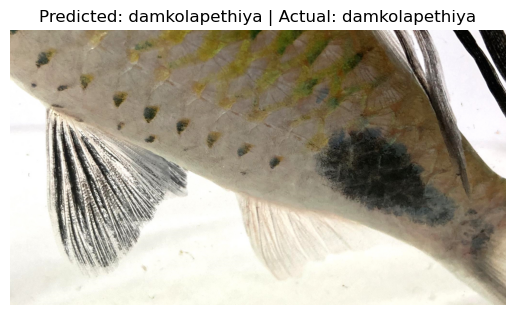

Image: damkolapethiya\2023_06_19_11_54_IMG_1789.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


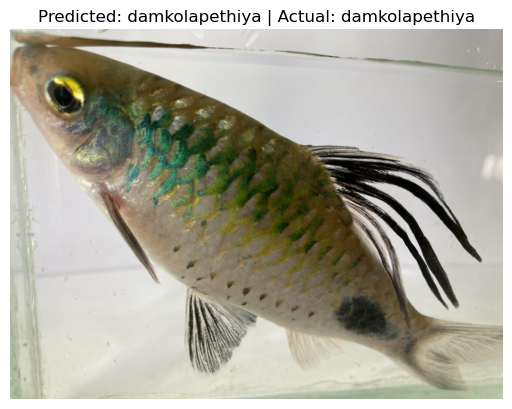

Image: damkolapethiya\2023_06_19_11_54_IMG_1797.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


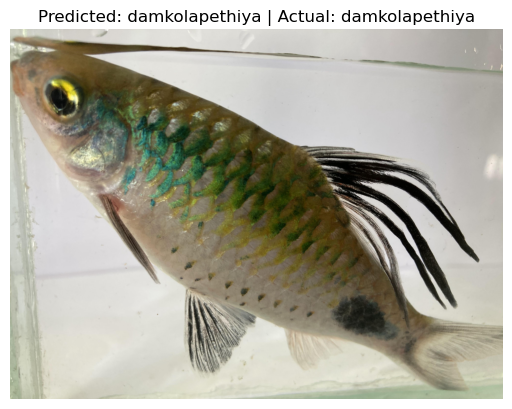

Image: damkolapethiya\2023_06_19_11_55_IMG_1804.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


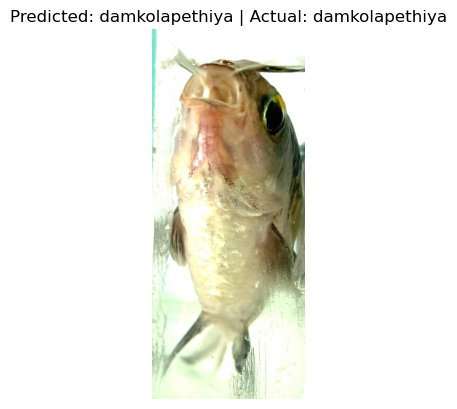

Image: damkolapethiya\2023_06_19_11_55_IMG_1819.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


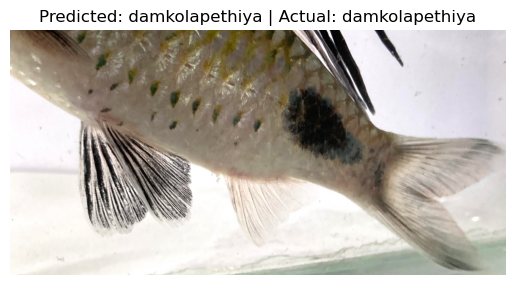

Image: damkolapethiya\2023_06_19_11_56_IMG_1861.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


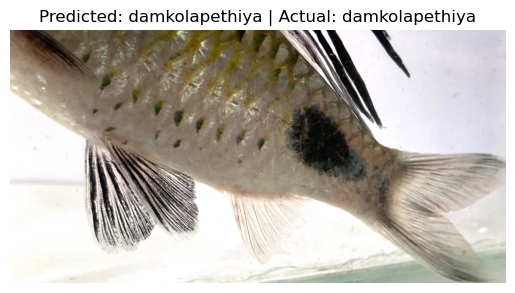

Image: damkolapethiya\2023_06_19_11_56_IMG_1863.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


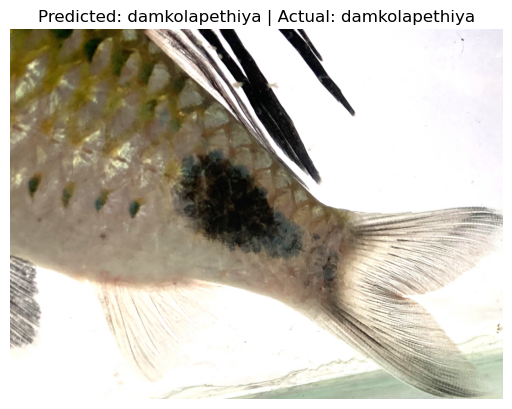

Image: damkolapethiya\2023_06_19_11_56_IMG_1866.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


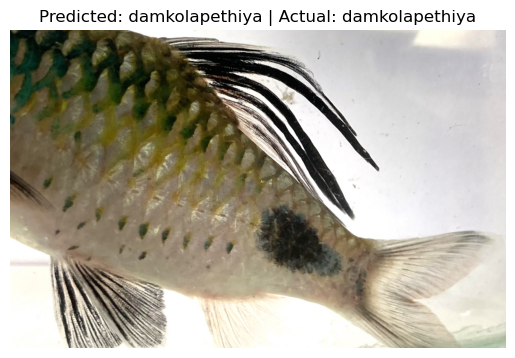

Image: damkolapethiya\2023_06_19_11_56_IMG_1869.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


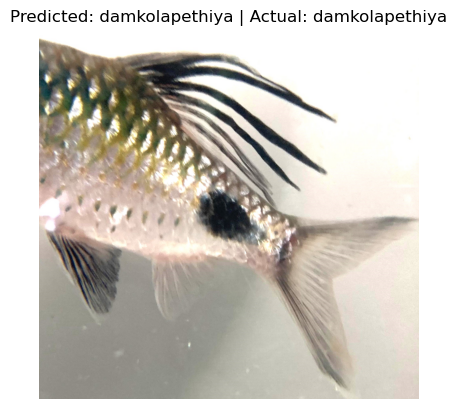

Image: damkolapethiya\2023_06_19_11_57_IMG_1879.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


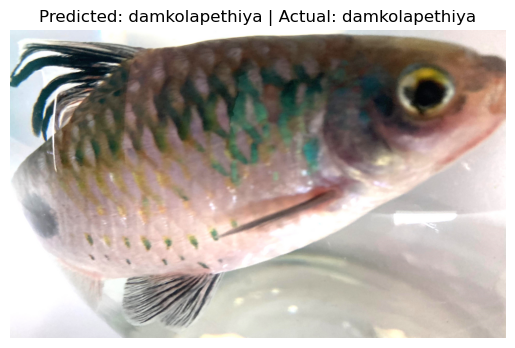

Image: damkolapethiya\2023_06_19_11_58_IMG_1952.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


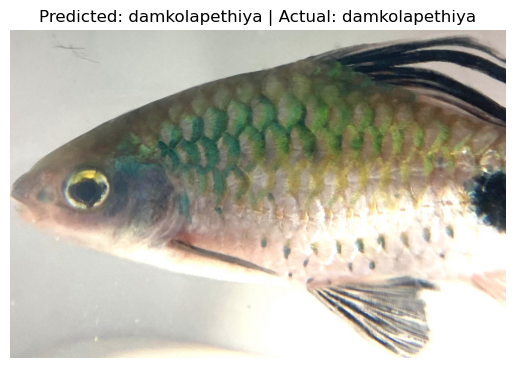

Image: damkolapethiya\2023_06_19_12_00_IMG_2028.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


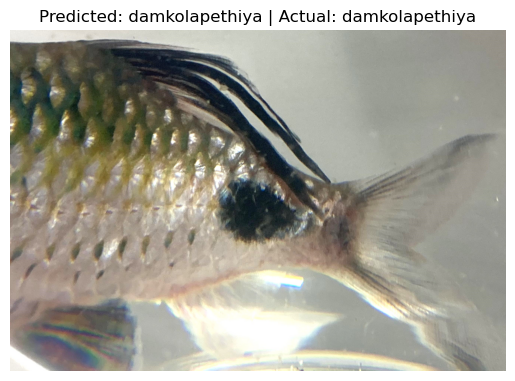

Image: damkolapethiya\2023_06_19_12_00_IMG_2052.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


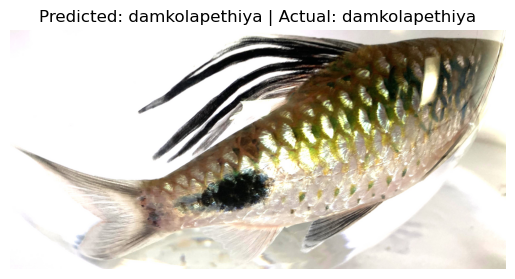

Image: damkolapethiya\2023_06_19_12_01_IMG_2083.JPG | Predicted: damkolapethiya | Actual: damkolapethiya


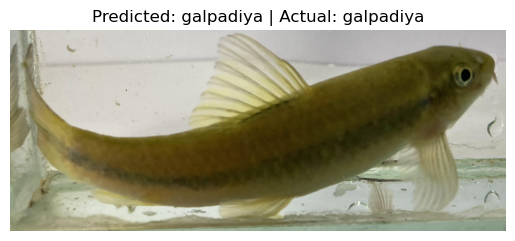

Image: galpadiya\2023_06_19_11_17_IMG_1140.JPG | Predicted: galpadiya | Actual: galpadiya


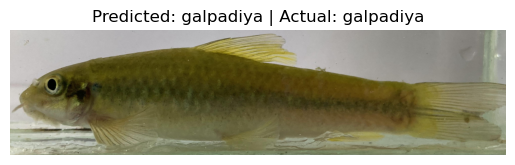

Image: galpadiya\2023_06_19_11_17_IMG_1149.JPG | Predicted: galpadiya | Actual: galpadiya


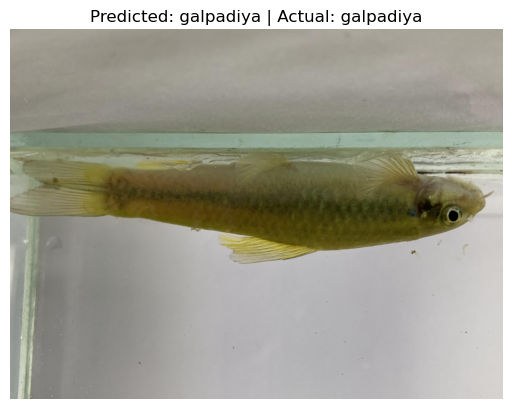

Image: galpadiya\2023_06_19_11_17_IMG_1151.JPG | Predicted: galpadiya | Actual: galpadiya


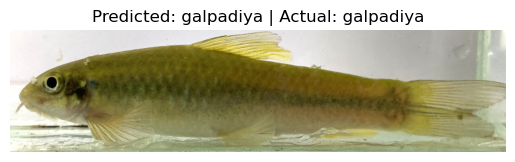

Image: galpadiya\2023_06_19_11_17_IMG_1152.JPG | Predicted: galpadiya | Actual: galpadiya


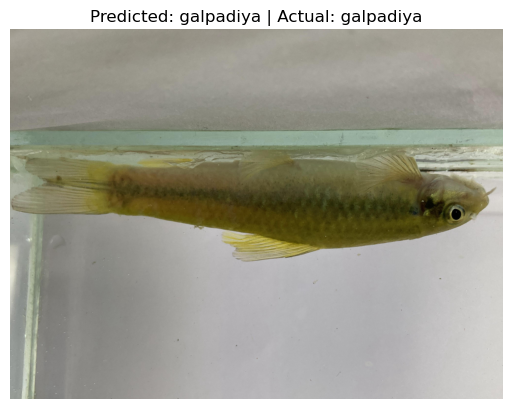

Image: galpadiya\2023_06_19_11_17_IMG_1155.JPG | Predicted: galpadiya | Actual: galpadiya


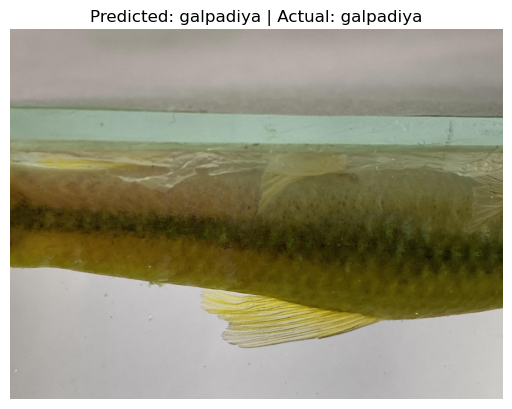

Image: galpadiya\2023_06_19_11_17_IMG_1166.JPG | Predicted: galpadiya | Actual: galpadiya


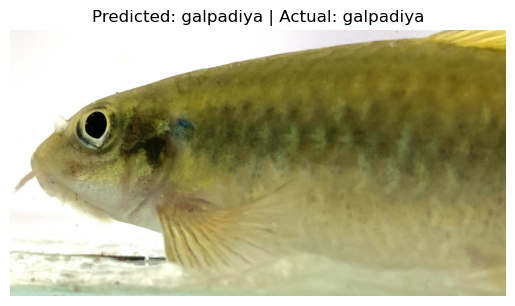

Image: galpadiya\2023_06_19_11_17_IMG_1169.JPG | Predicted: galpadiya | Actual: galpadiya


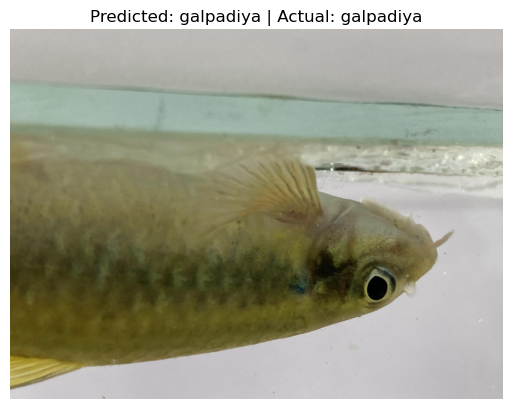

Image: galpadiya\2023_06_19_11_17_IMG_1173.JPG | Predicted: galpadiya | Actual: galpadiya


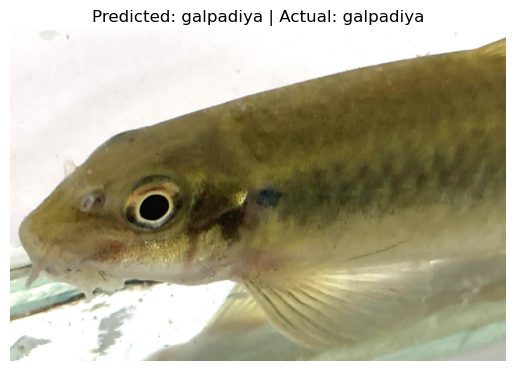

Image: galpadiya\2023_06_19_11_18_IMG_1207.JPG | Predicted: galpadiya | Actual: galpadiya


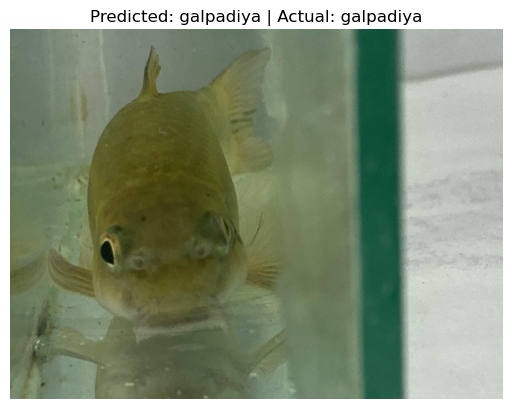

Image: galpadiya\2023_06_19_11_19_IMG_1227.JPG | Predicted: galpadiya | Actual: galpadiya


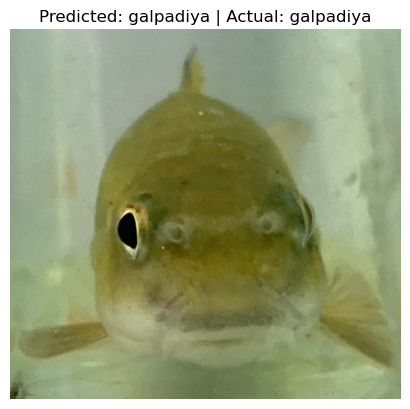

Image: galpadiya\2023_06_19_11_20_IMG_1232.JPG | Predicted: galpadiya | Actual: galpadiya


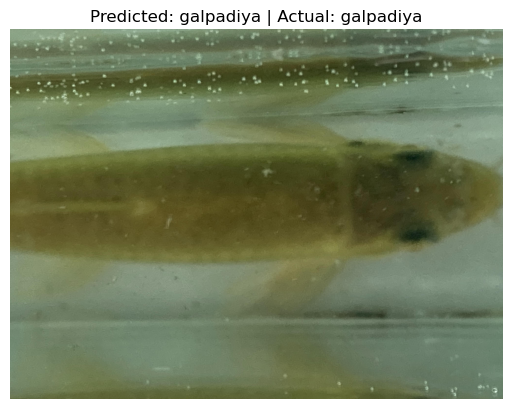

Image: galpadiya\2023_06_19_11_21_IMG_1254.JPG | Predicted: galpadiya | Actual: galpadiya


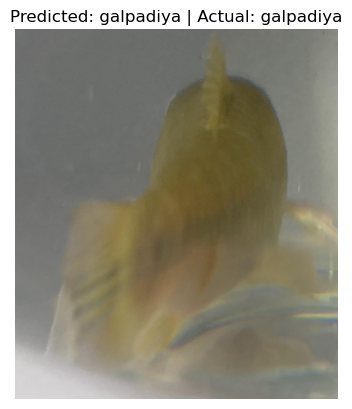

Image: galpadiya\2023_06_19_11_24_IMG_1300.JPG | Predicted: galpadiya | Actual: galpadiya


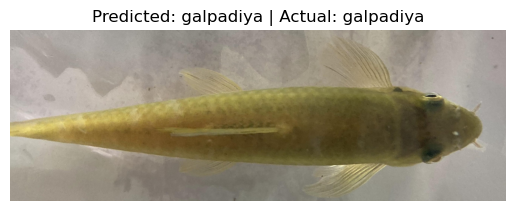

Image: galpadiya\2023_06_19_11_24_IMG_1327.JPG | Predicted: galpadiya | Actual: galpadiya


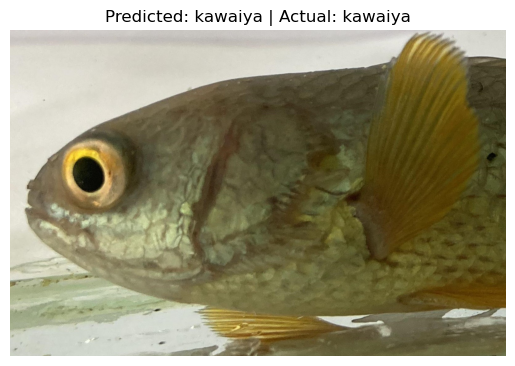

Image: kawaiya\2023_06_19_11_32_IMG_1375.JPG | Predicted: kawaiya | Actual: kawaiya


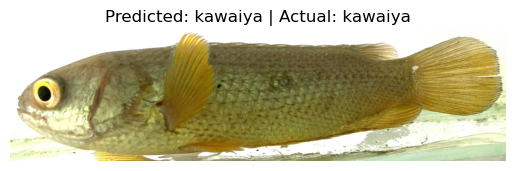

Image: kawaiya\2023_06_19_11_32_IMG_1376.JPG | Predicted: kawaiya | Actual: kawaiya


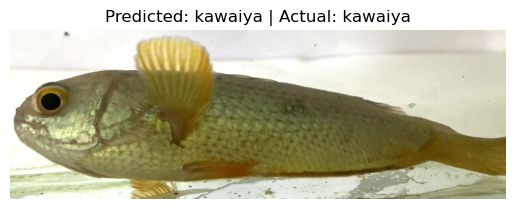

Image: kawaiya\2023_06_19_11_32_IMG_1377.JPG | Predicted: kawaiya | Actual: kawaiya


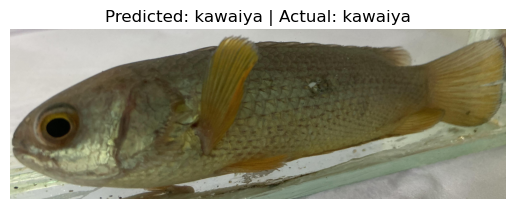

Image: kawaiya\2023_06_19_11_32_IMG_1381.JPG | Predicted: kawaiya | Actual: kawaiya


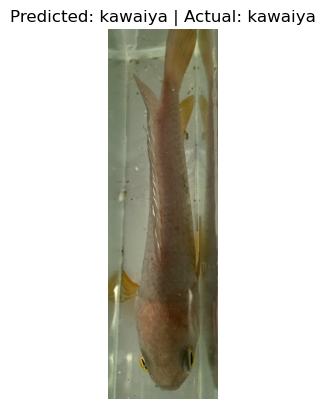

Image: kawaiya\2023_06_19_11_34_IMG_1421.JPG | Predicted: kawaiya | Actual: kawaiya


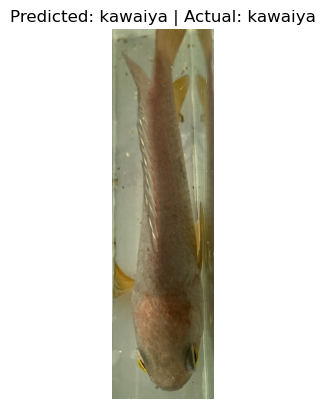

Image: kawaiya\2023_06_19_11_34_IMG_1431.JPG | Predicted: kawaiya | Actual: kawaiya


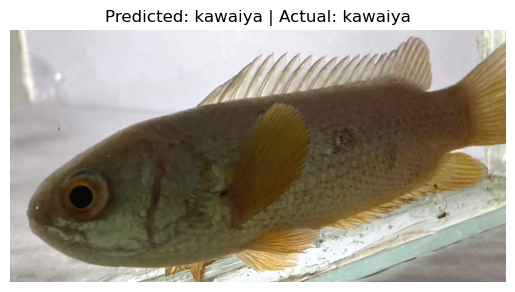

Image: kawaiya\2023_06_19_11_34_IMG_1432.JPG | Predicted: kawaiya | Actual: kawaiya


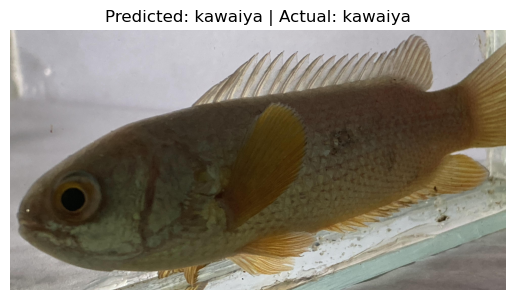

Image: kawaiya\2023_06_19_11_34_IMG_1433.JPG | Predicted: kawaiya | Actual: kawaiya


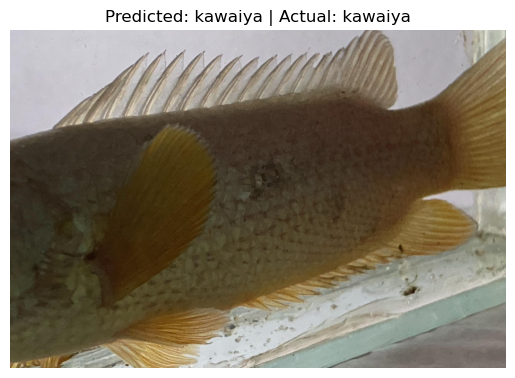

Image: kawaiya\2023_06_19_11_34_IMG_1434.JPG | Predicted: kawaiya | Actual: kawaiya


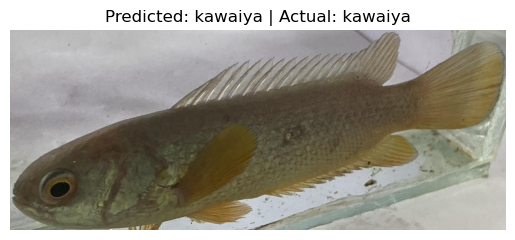

Image: kawaiya\2023_06_19_11_34_IMG_1447.JPG | Predicted: kawaiya | Actual: kawaiya


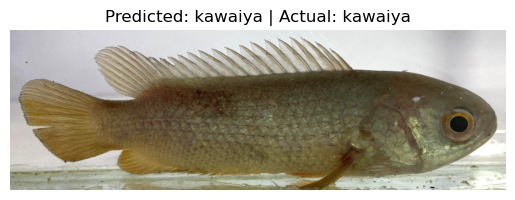

Image: kawaiya\2023_06_19_11_36_IMG_1496.JPG | Predicted: kawaiya | Actual: kawaiya


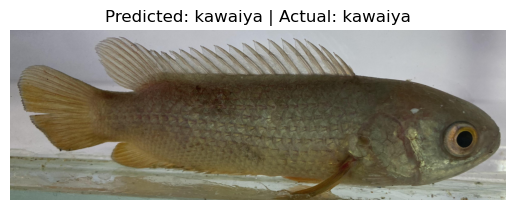

Image: kawaiya\2023_06_19_11_36_IMG_1505.JPG | Predicted: kawaiya | Actual: kawaiya


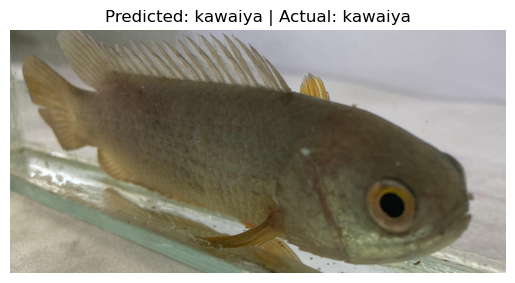

Image: kawaiya\2023_06_19_11_36_IMG_1507.JPG | Predicted: kawaiya | Actual: kawaiya


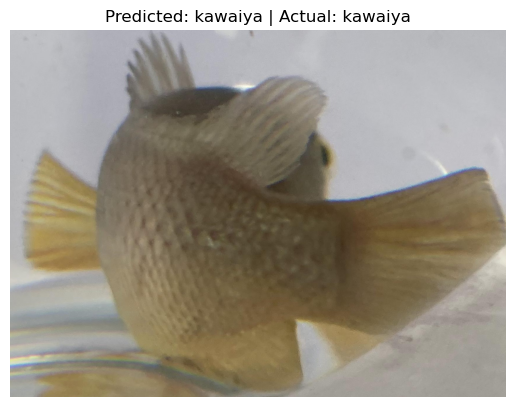

Image: kawaiya\2023_06_19_11_38_IMG_1531.JPG | Predicted: kawaiya | Actual: kawaiya


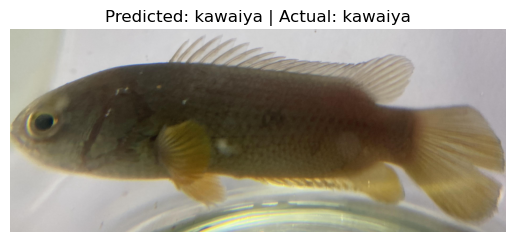

Image: kawaiya\2023_06_19_11_40_IMG_1633.JPG | Predicted: kawaiya | Actual: kawaiya


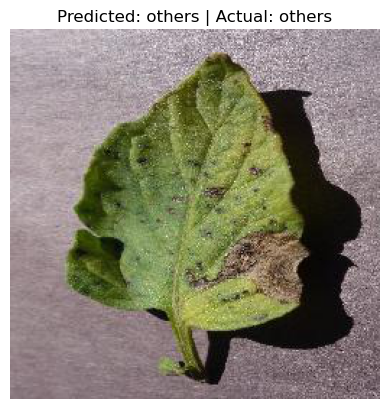

Image: others\00e7c4b2-3005-4558-9cfa-235e356cb7a8___RS_Erly.B 7844.JPG | Predicted: others | Actual: others


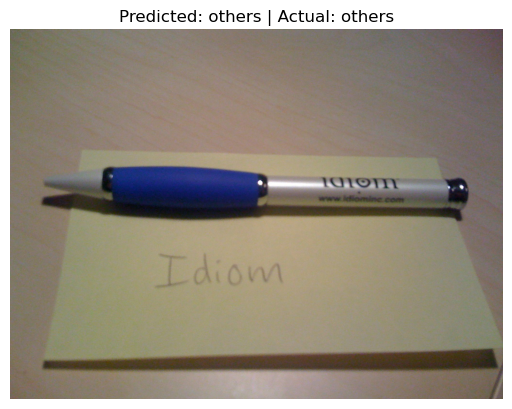

Image: others\085e00cca29a39a5.jpg | Predicted: others | Actual: others


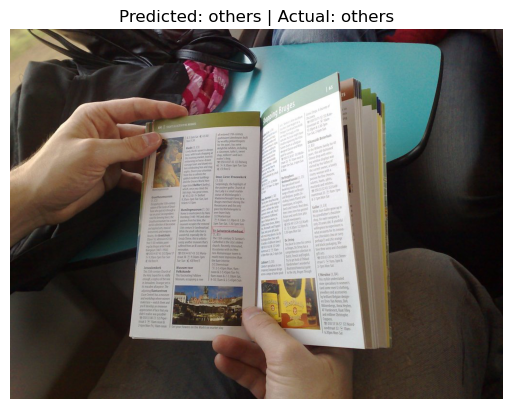

Image: others\08e6091538ee52b7.jpg | Predicted: others | Actual: others


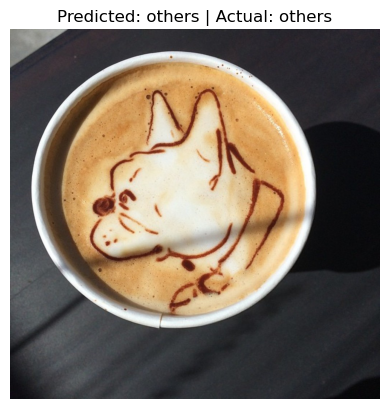

Image: others\09d251bc6d2df174.jpg | Predicted: others | Actual: others


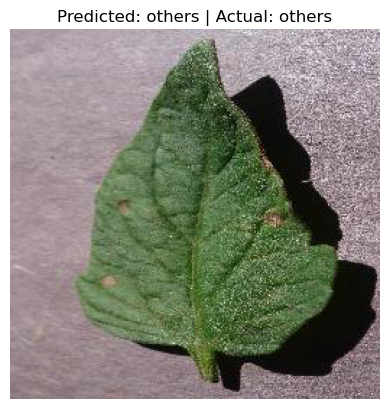

Image: others\0a2726e0-3358-4a46-b6dc-563a5a9f2bdf___RS_Erly.B 7860.JPG | Predicted: others | Actual: others


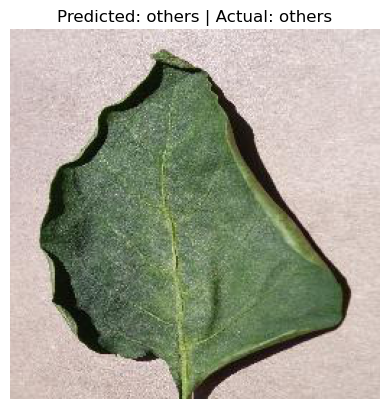

Image: others\0b796b7a-dfc8-47f7-9970-8373263c6408___JR_HL 5948.JPG | Predicted: others | Actual: others


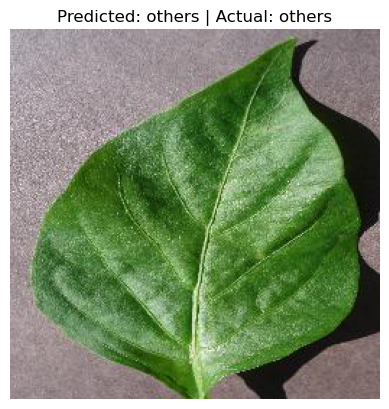

Image: others\0ba474dd-0cfd-4fd2-a58c-8e3d18dbe7c3___JR_HL 8395.JPG | Predicted: others | Actual: others


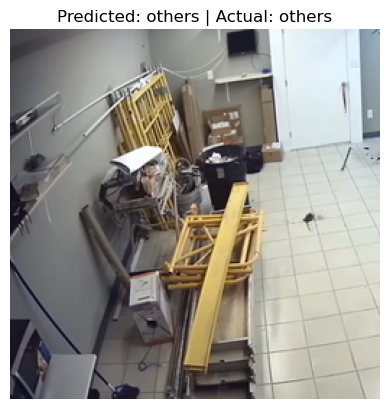

Image: others\108.png | Predicted: others | Actual: others


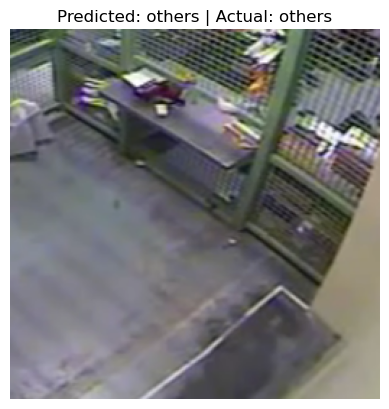

Image: others\115.png | Predicted: others | Actual: others


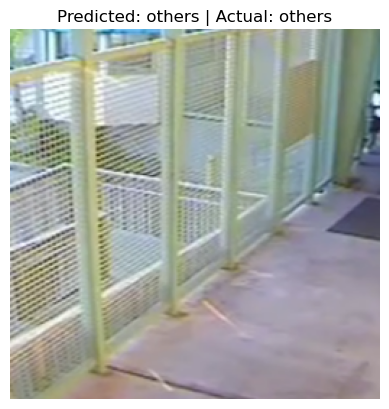

Image: others\116.png | Predicted: others | Actual: others


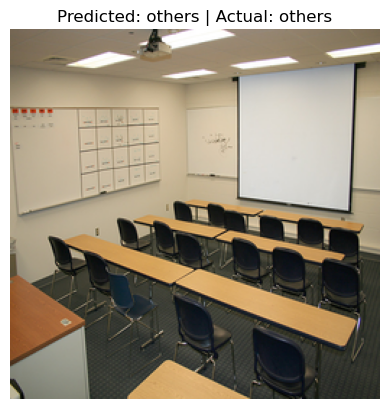

Image: others\121.png | Predicted: others | Actual: others


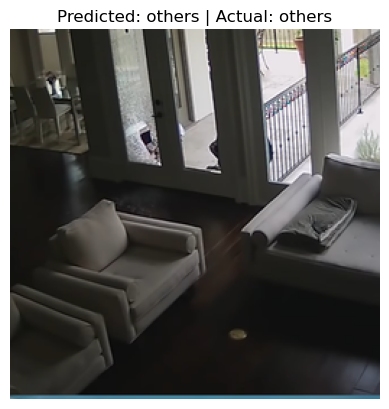

Image: others\125.png | Predicted: others | Actual: others


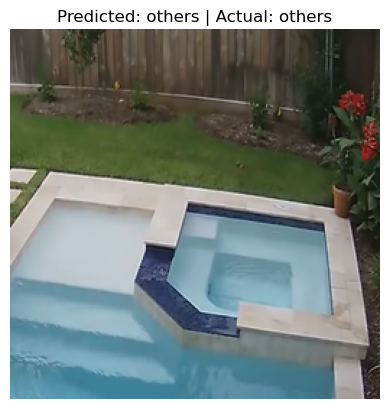

Image: others\126.png | Predicted: others | Actual: others


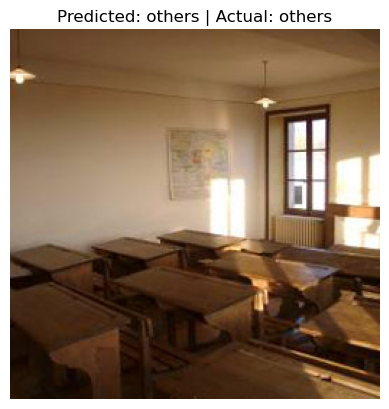

Image: others\13.png | Predicted: others | Actual: others


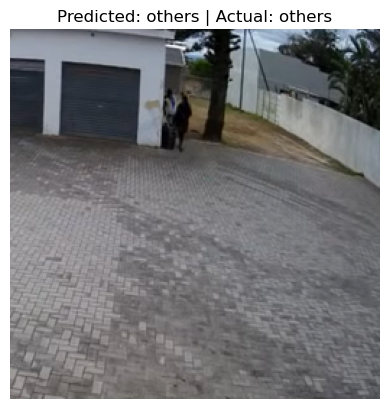

Image: others\132.png | Predicted: others | Actual: others


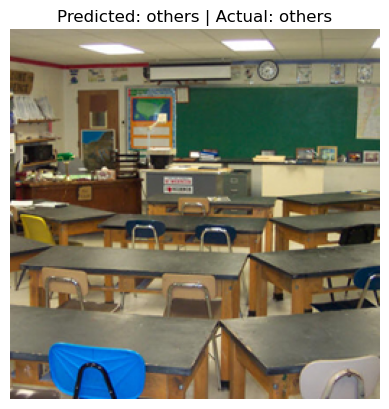

Image: others\133.png | Predicted: others | Actual: others


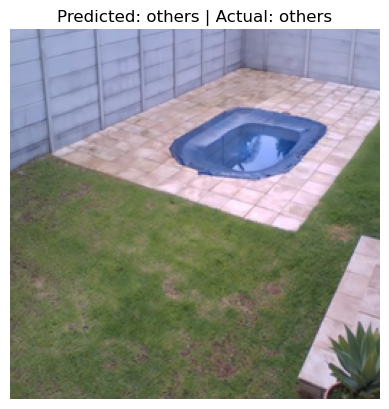

Image: others\140.png | Predicted: others | Actual: others


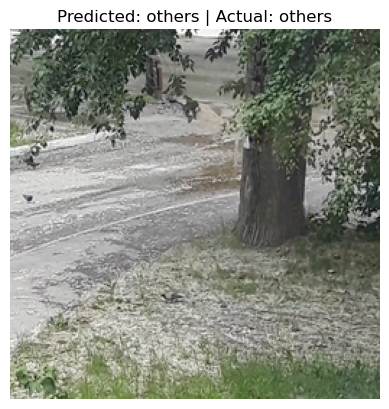

Image: others\162.png | Predicted: others | Actual: others


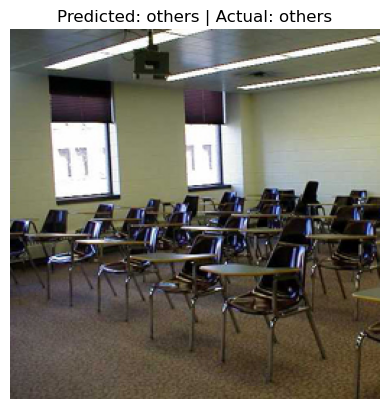

Image: others\176.png | Predicted: others | Actual: others


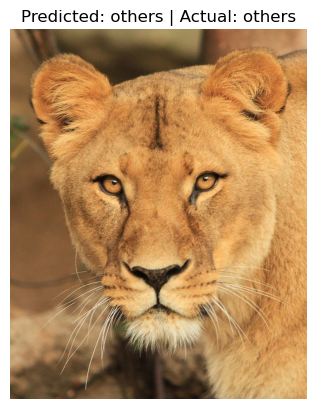

Image: others\1ada34762fa759563d29f3a9d1fb9029.jpg | Predicted: others | Actual: others


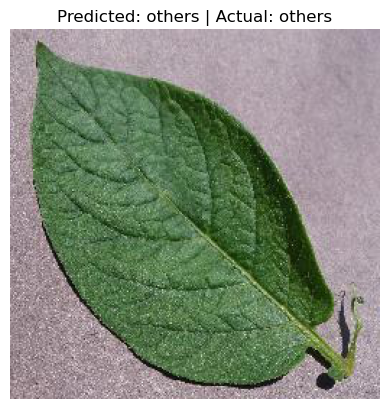

Image: others\1dcfeaa9-006d-470c-b3e5-d67609d07d4e___RS_HL 1808.JPG | Predicted: others | Actual: others


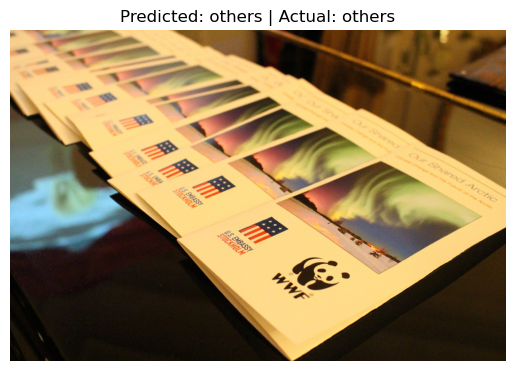

Image: others\206a0f4f02499cdc.jpg | Predicted: others | Actual: others


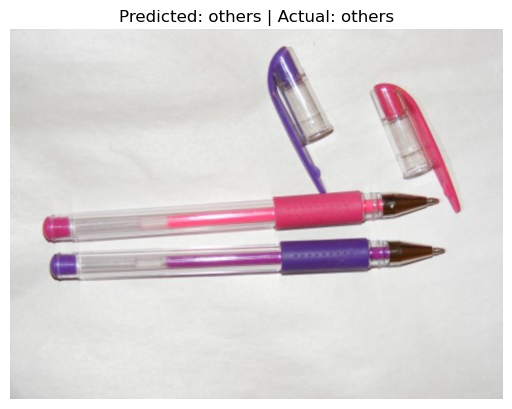

Image: others\3018a239d33dc417.jpg | Predicted: others | Actual: others


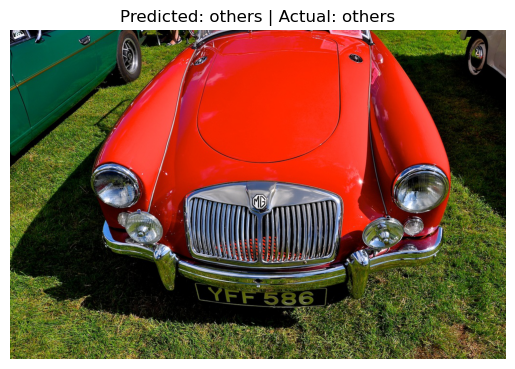

Image: others\365873800828691a.jpg | Predicted: others | Actual: others


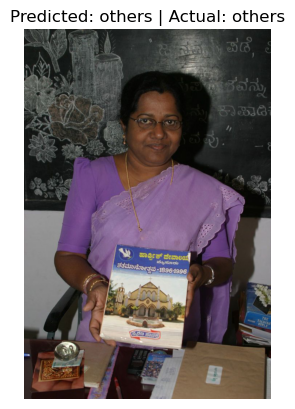

Image: others\4414863693130d28.jpg | Predicted: others | Actual: others


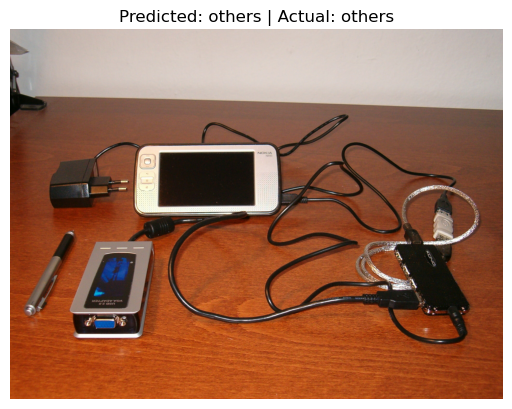

Image: others\4615609a7670cdf3.jpg | Predicted: others | Actual: others


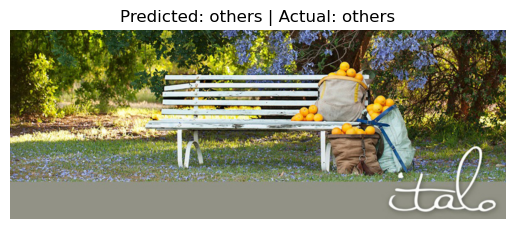

Image: others\468e52eb668d59b2.jpg | Predicted: others | Actual: others


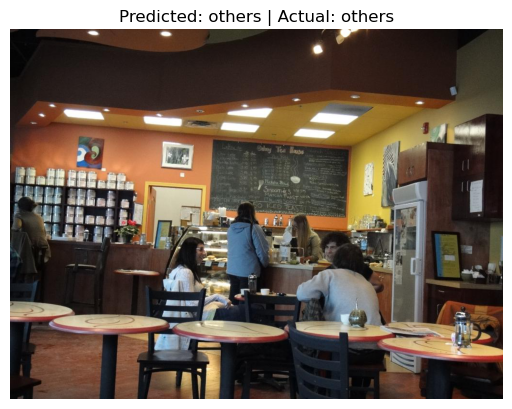

Image: others\49975d124993e170.jpg | Predicted: others | Actual: others


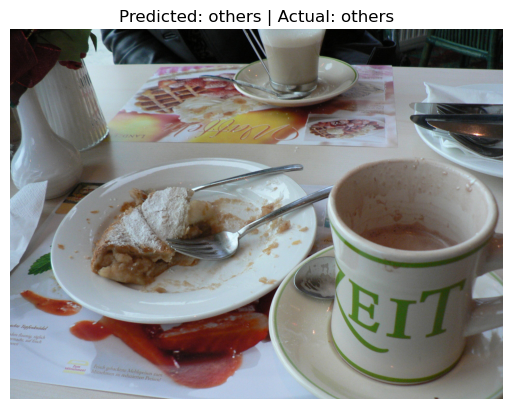

Image: others\4f2d1d0a898e5c2e.jpg | Predicted: others | Actual: others


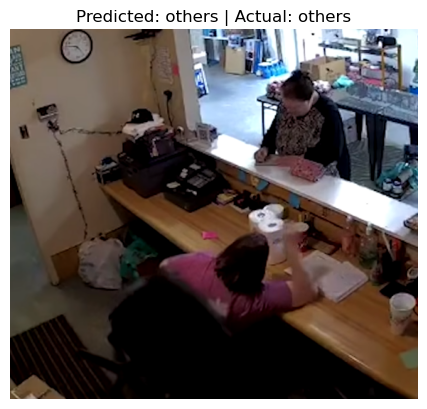

Image: others\528.png | Predicted: others | Actual: others


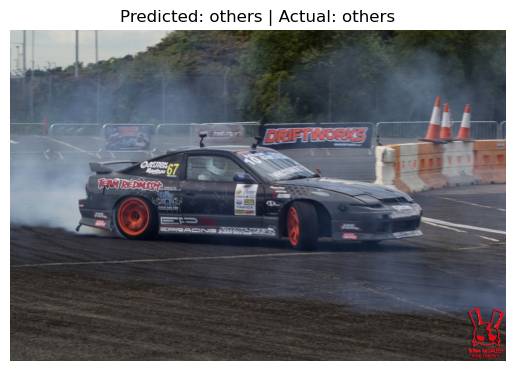

Image: others\59d06dba90f9370c.jpg | Predicted: others | Actual: others


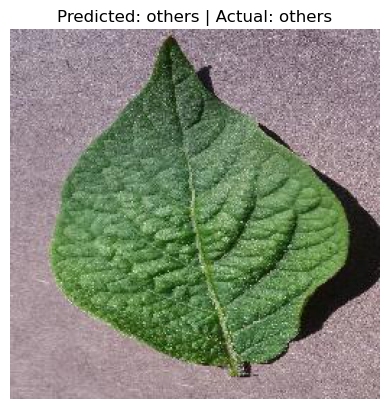

Image: others\5ea316eb-10a2-42c0-b781-40d90356ccaa___RS_HL 1935.JPG | Predicted: others | Actual: others


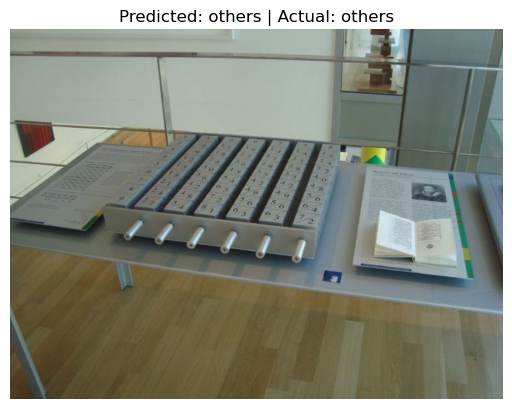

Image: others\6404d1839b2a69e4.jpg | Predicted: others | Actual: others


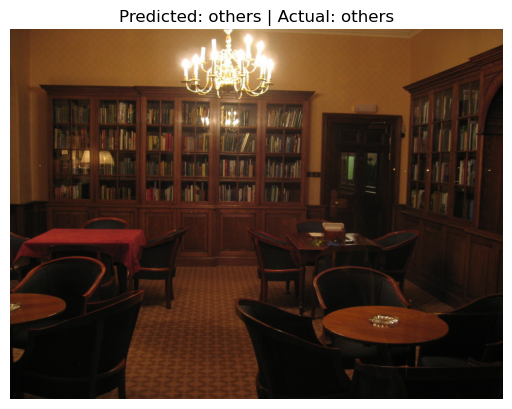

Image: others\66cc445b7684c406.jpg | Predicted: others | Actual: others


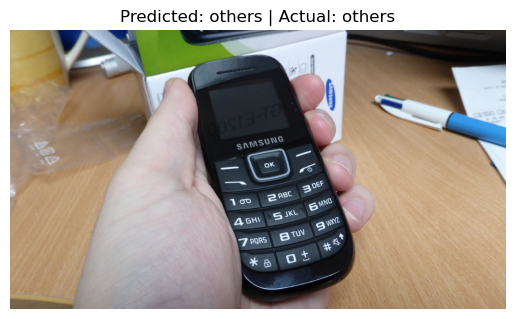

Image: others\6e16a23506b95f4d.jpg | Predicted: others | Actual: others


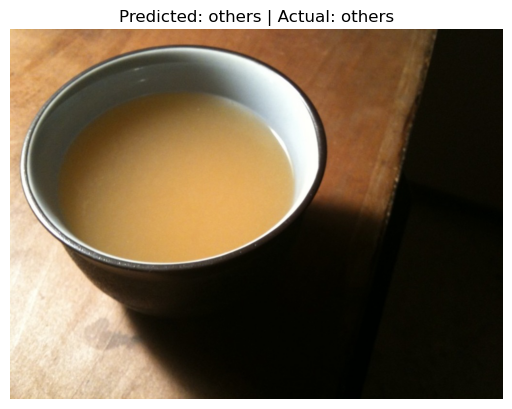

Image: others\6eda907aa91a7b6b.jpg | Predicted: others | Actual: others


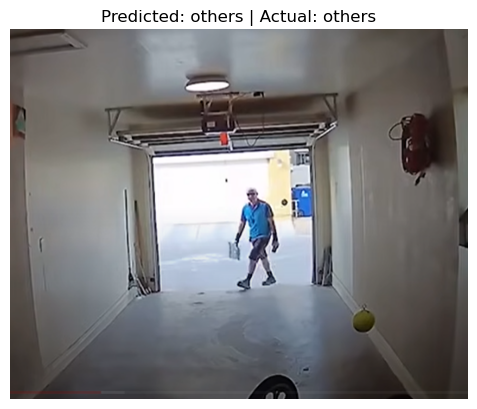

Image: others\85.png | Predicted: others | Actual: others


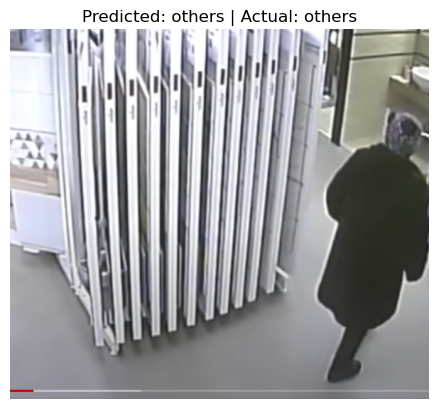

Image: others\88.png | Predicted: others | Actual: others


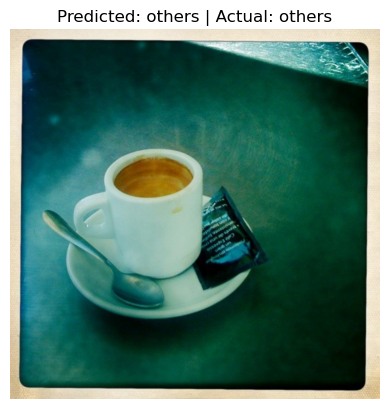

Image: others\8a63e41d54d113ca.jpg | Predicted: others | Actual: others


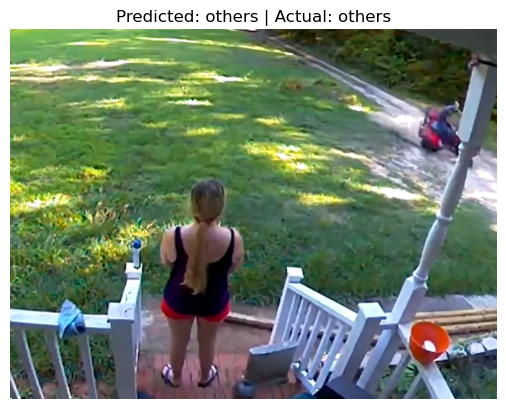

Image: others\91.png | Predicted: others | Actual: others


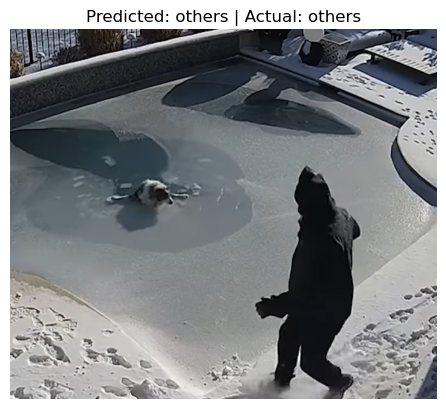

Image: others\93.png | Predicted: others | Actual: others


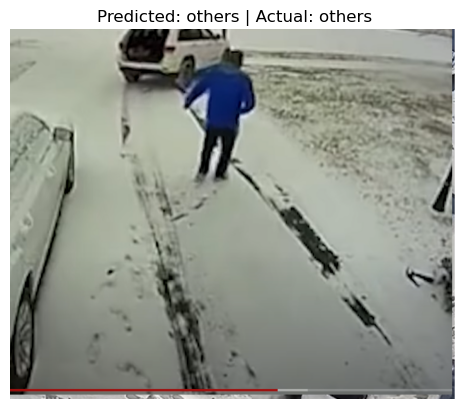

Image: others\94.png | Predicted: others | Actual: others


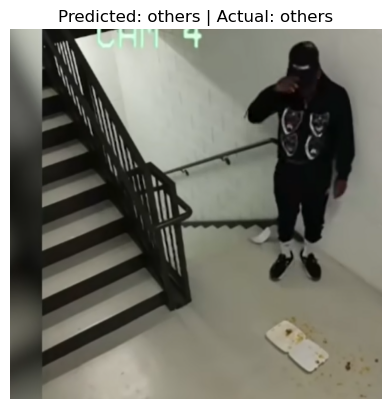

Image: others\97.png | Predicted: others | Actual: others


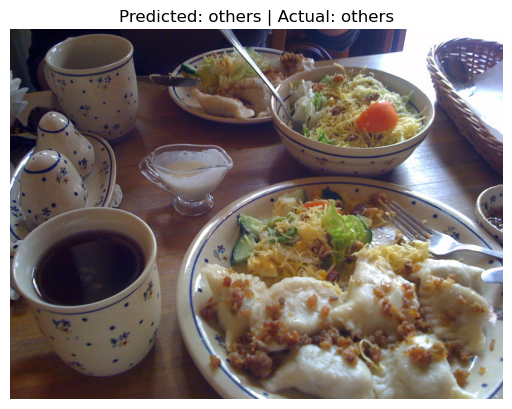

Image: others\9f761e3b253b24d0.jpg | Predicted: others | Actual: others


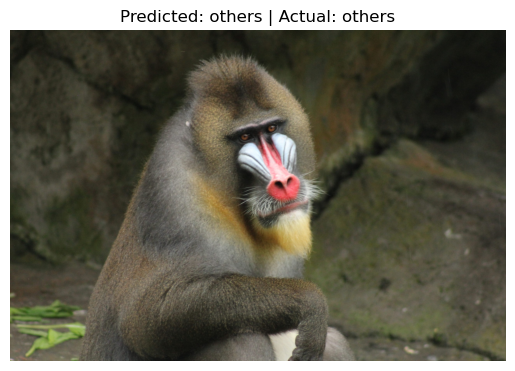

Image: others\IMG_7019-scaled.jpg | Predicted: others | Actual: others


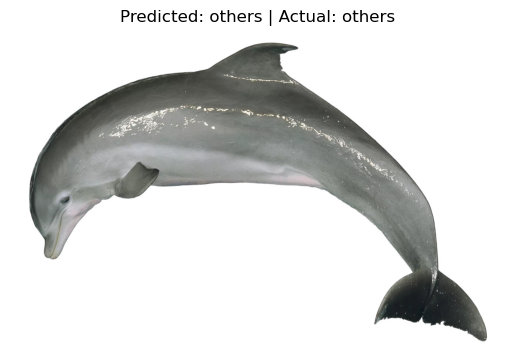

Image: others\MA_00659840_fevfnc.jpg | Predicted: others | Actual: others


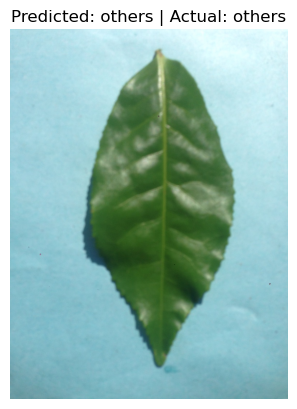

Image: others\UNADJUSTEDNONRAW_thumb_20b.jpg | Predicted: others | Actual: others


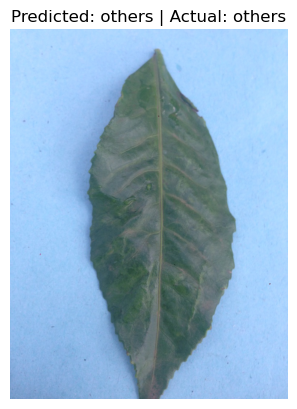

Image: others\UNADJUSTEDNONRAW_thumb_21a.jpg | Predicted: others | Actual: others


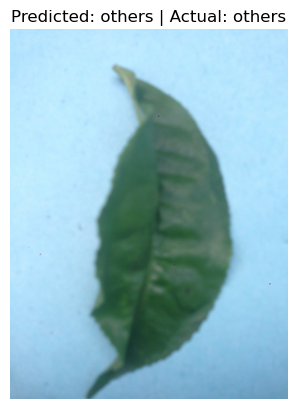

Image: others\UNADJUSTEDNONRAW_thumb_22a.jpg | Predicted: others | Actual: others


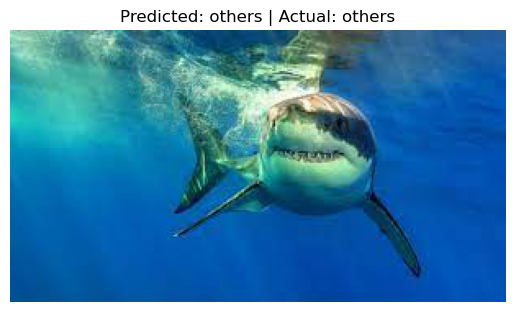

Image: others\Untitled.jpg | Predicted: others | Actual: others


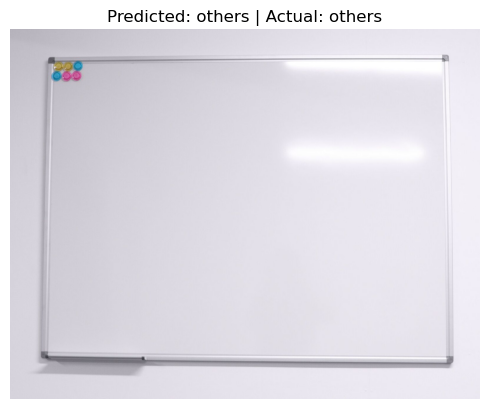

Image: others\W1812.jpg | Predicted: others | Actual: others


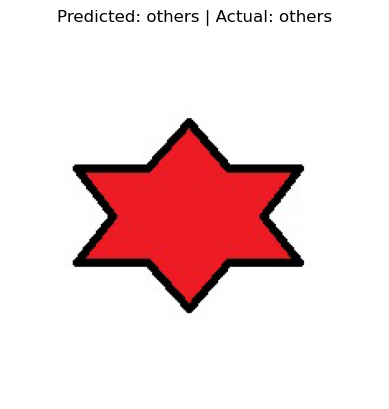

Image: others\a (1).jpg | Predicted: others | Actual: others


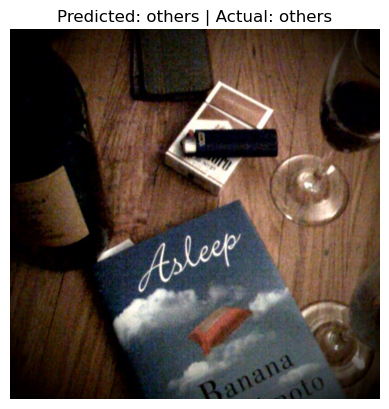

Image: others\b8cce963b2aed20e.jpg | Predicted: others | Actual: others


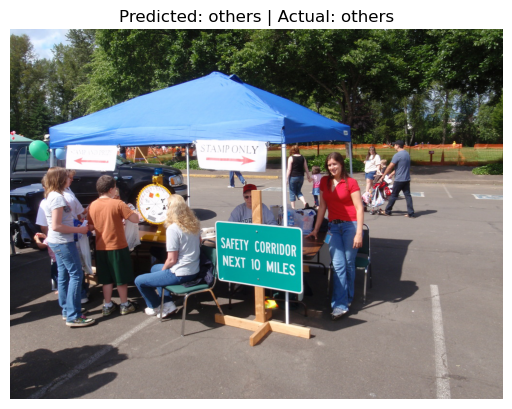

Image: others\bbcd0ae0e16c39ea.jpg | Predicted: others | Actual: others


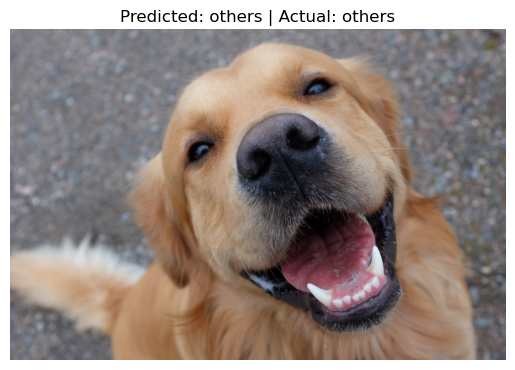

Image: others\cq5dam.web.1280.1280.jpeg | Predicted: others | Actual: others


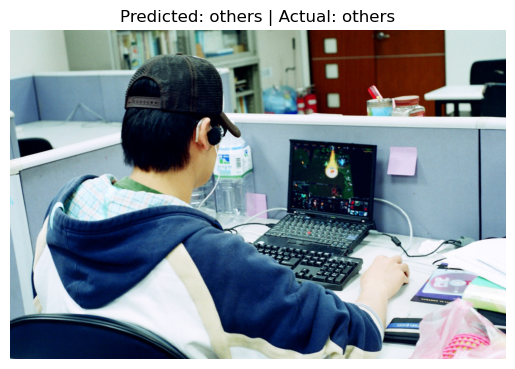

Image: others\d06f7dde4e4821b3.jpg | Predicted: others | Actual: others


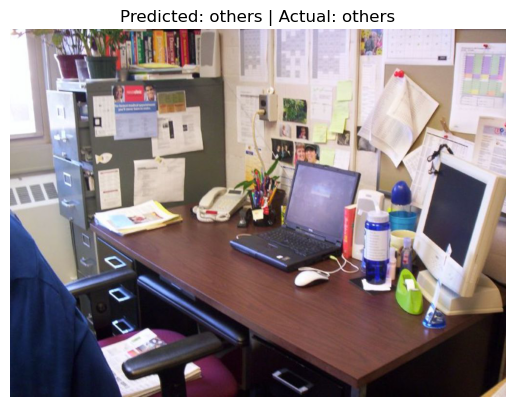

Image: others\d71a337b059ba1db.jpg | Predicted: others | Actual: others


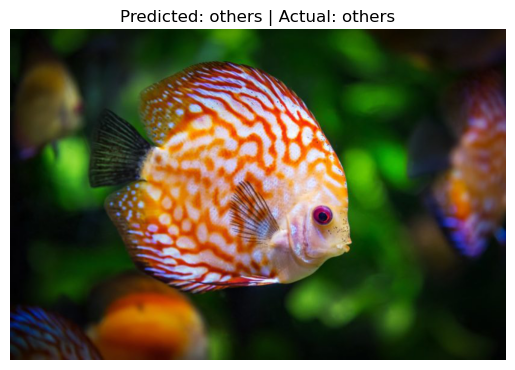

Image: others\fish-discus-swimming-825x550.jpg | Predicted: others | Actual: others


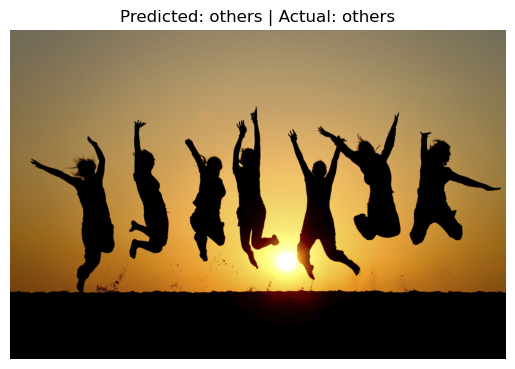

Image: others\happypeople-1024x679.jpg | Predicted: others | Actual: others


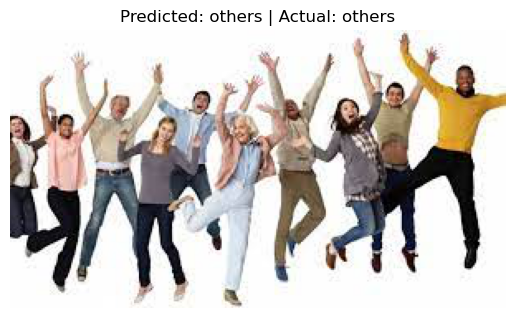

Image: others\image17.jpeg | Predicted: others | Actual: others


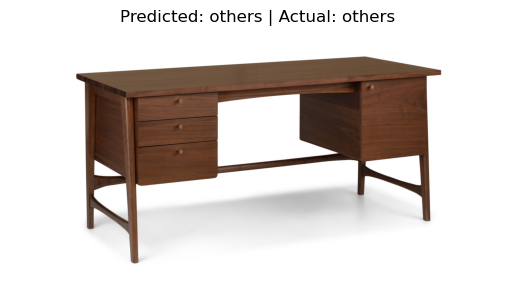

Image: others\image84734.jpg | Predicted: others | Actual: others


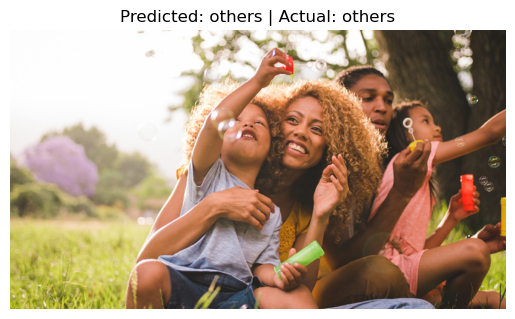

Image: others\nm-how-happiness-affects-health-tnail.jpg | Predicted: others | Actual: others


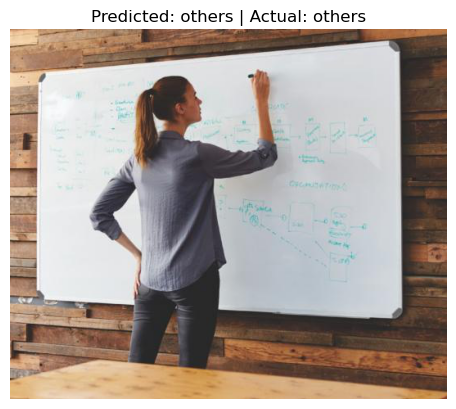

Image: others\nobo_580x.jpg | Predicted: others | Actual: others


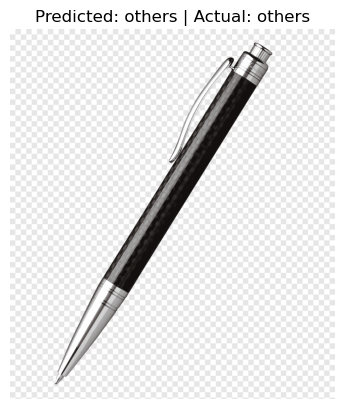

Image: others\png-clipart-parker-pen-company-ballpoint-pen-stationery-rollerball-pen-pen-office-pen.png | Predicted: others | Actual: others


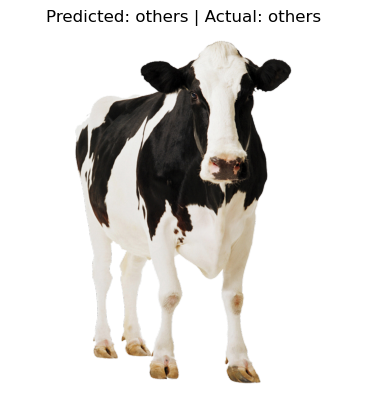

Image: others\pngimg.com - cow_PNG50610.png | Predicted: others | Actual: others


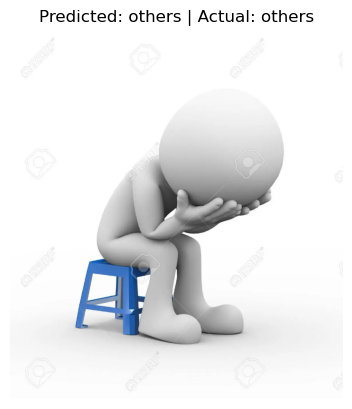

Image: others\strated-depressed-man-sitting-on-plastic-stool-3d-white-people-man-character.jpg | Predicted: others | Actual: others


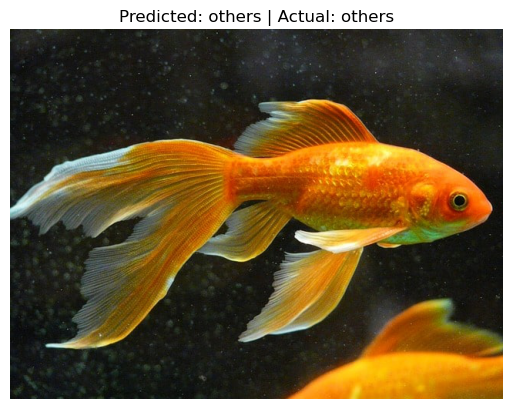

Image: others\veiltail-goldfish.jpg | Predicted: others | Actual: others


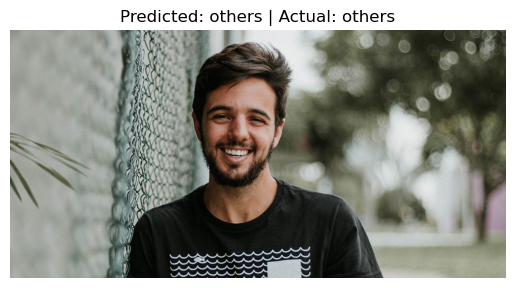

Image: others\web3-happy-people-outside-smile-sun-nature-eduardo-dutra-620857-unsplash.jpg | Predicted: others | Actual: others


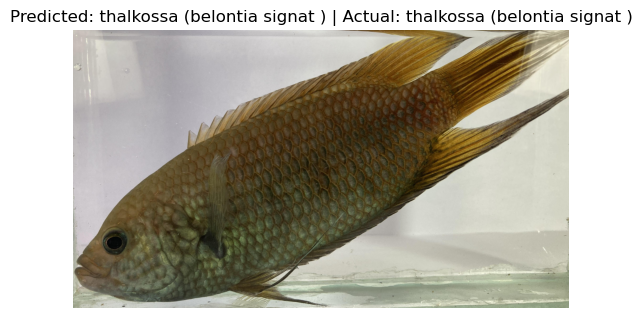

Image: thalkossa (belontia signat )\2023_06_19_10_10_IMG_0225.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


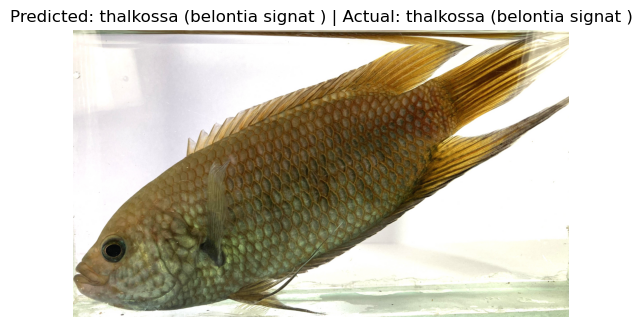

Image: thalkossa (belontia signat )\2023_06_19_10_10_IMG_0226.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


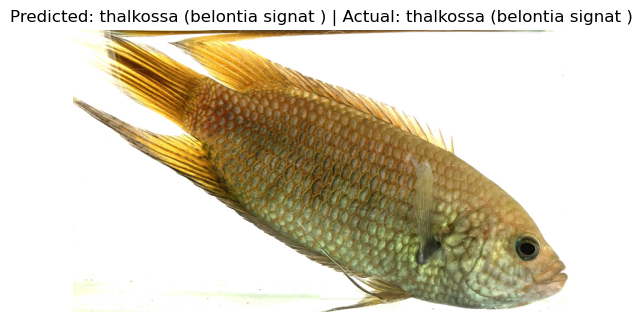

Image: thalkossa (belontia signat )\2023_06_19_10_10_IMG_0227.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


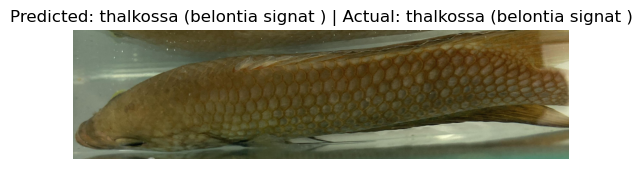

Image: thalkossa (belontia signat )\2023_06_19_10_11_IMG_0244.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


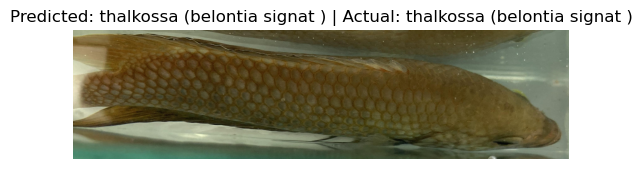

Image: thalkossa (belontia signat )\2023_06_19_10_11_IMG_0245.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


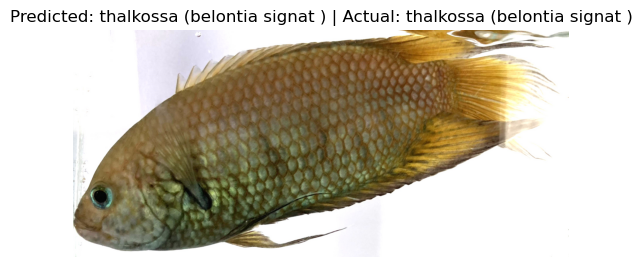

Image: thalkossa (belontia signat )\2023_06_19_10_11_IMG_0251.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


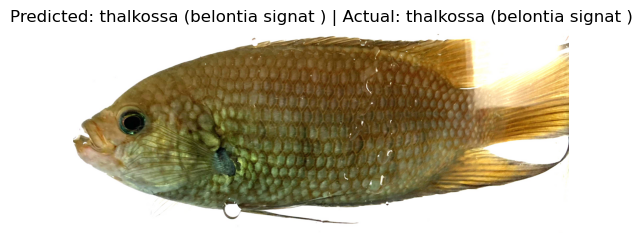

Image: thalkossa (belontia signat )\2023_06_19_10_12_IMG_0253.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


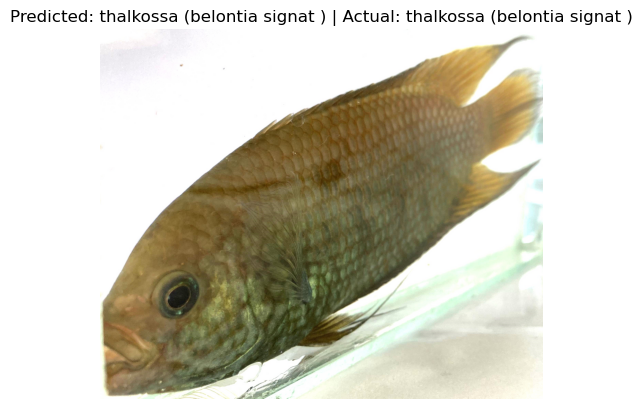

Image: thalkossa (belontia signat )\2023_06_19_10_12_IMG_0260.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


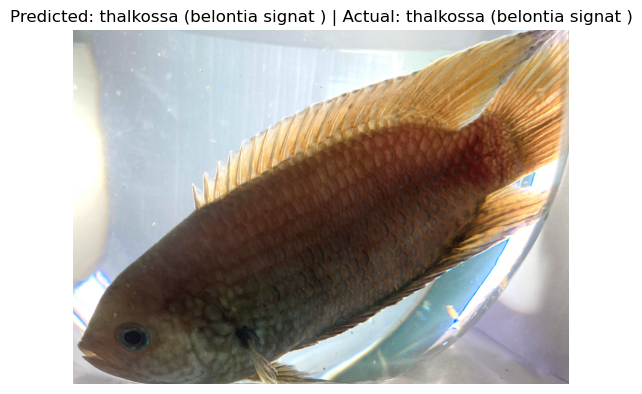

Image: thalkossa (belontia signat )\2023_06_19_10_19_IMG_0303.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


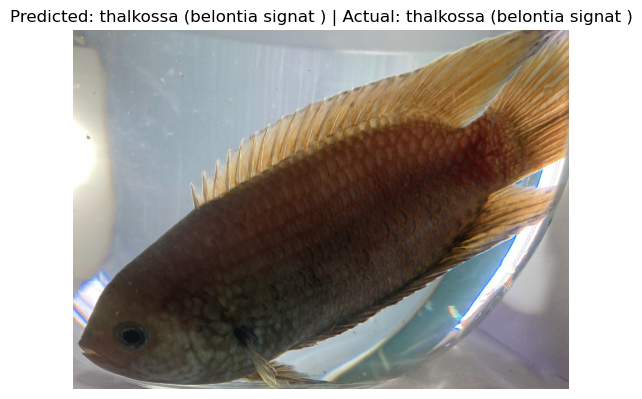

Image: thalkossa (belontia signat )\2023_06_19_10_19_IMG_0305.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


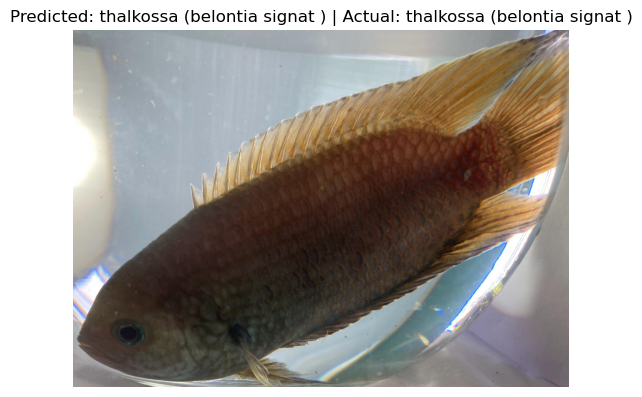

Image: thalkossa (belontia signat )\2023_06_19_10_19_IMG_0307.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


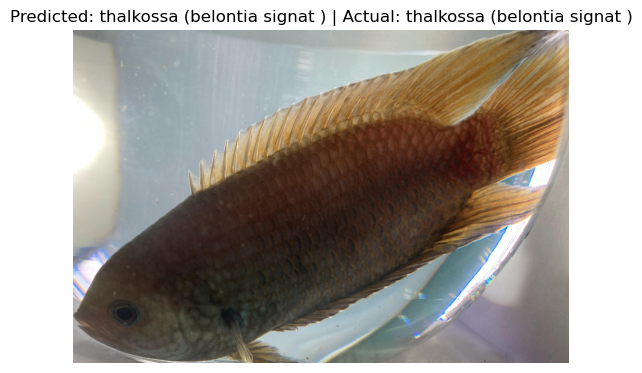

Image: thalkossa (belontia signat )\2023_06_19_10_20_IMG_0310.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


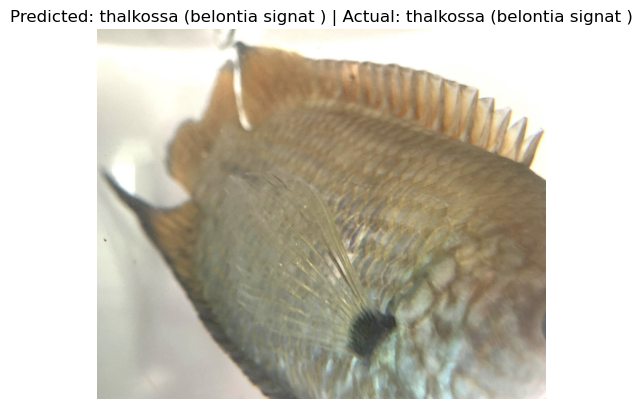

Image: thalkossa (belontia signat )\2023_06_19_10_20_IMG_0322.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


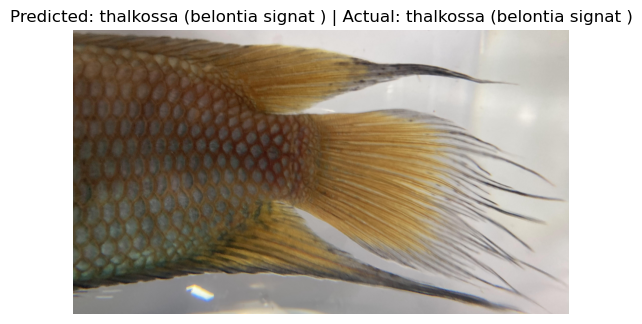

Image: thalkossa (belontia signat )\2023_06_19_10_23_IMG_0383.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


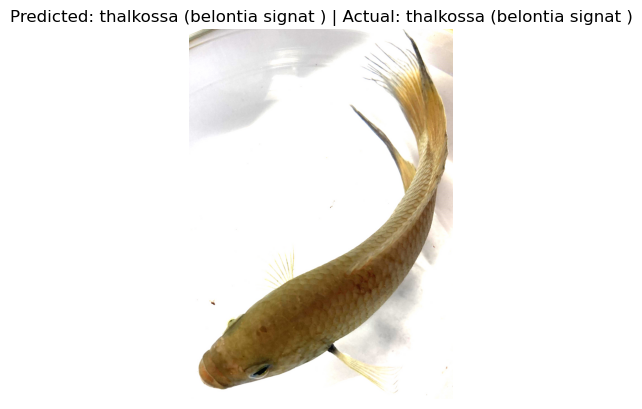

Image: thalkossa (belontia signat )\2023_06_19_10_27_IMG_0441.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


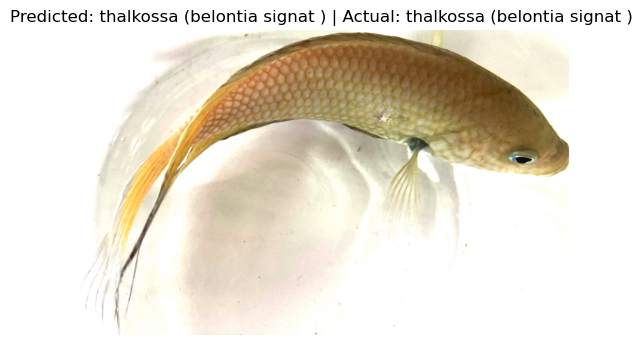

Image: thalkossa (belontia signat )\2023_06_19_10_30_IMG_0507.JPG | Predicted: thalkossa (belontia signat ) | Actual: thalkossa (belontia signat )


In [24]:
from PIL import Image
import matplotlib.pyplot as plt

# Get predictions from the model
predictions = final_model.predict(test_batches)

# Convert predicted probabilities to class labels
predicted_labels = predictions.argmax(axis=-1)

# Get actual labels from the 'test_batches' object
actual_labels = test_batches.classes

# Get class names from the 'test_batches' object
class_names = list(test_batches.class_indices.keys())

# Iterate through the test batch and display image, predicted label, and actual label
for i in range(len(test_batches.filenames)):
    image_filename = test_batches.filenames[i]
    predicted_class_name = class_names[predicted_labels[i]]
    actual_class_name = class_names[actual_labels[i]]
    
    # Load and display the image using PIL
    image_path = "C:/Users/Sameera maduSanka/Downloads/sam MobileNet/dataSet/test/" + image_filename  # Replace with the actual path to your test dataset
    image = Image.open(image_path)
    plt.imshow(image)
    plt.title(f"Predicted: {predicted_class_name} | Actual: {actual_class_name}")
    plt.axis('off')
    plt.show()
    
    print(f"Image: {image_filename} | Predicted: {predicted_class_name} | Actual: {actual_class_name}")

16/16 [==============================] - 6s 383ms/step


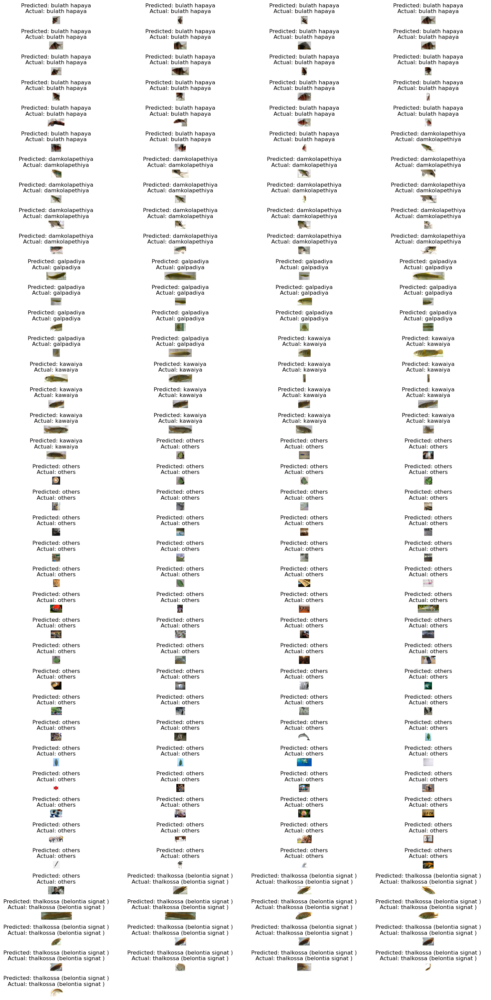

In [25]:
from PIL import Image
import matplotlib.pyplot as plt

from PIL import Image
import matplotlib.pyplot as plt

# Get predictions from the model
predictions = final_model.predict(test_batches)

# Convert predicted probabilities to class labels
predicted_labels = predictions.argmax(axis=-1)

# Get actual labels from the 'test_batches' object
actual_labels = test_batches.classes

# Get class names from the 'test_batches' object
class_names = list(test_batches.class_indices.keys())

# Specify the number of columns for the grid
num_columns = 4

# Calculate the number of rows needed based on the number of images and columns
num_images = len(test_batches.filenames)
num_rows = -(-num_images // num_columns)  # Ceiling division

# Create a subplot grid for displaying images
fig, axes = plt.subplots(num_rows, num_columns, figsize=(15, 30))

# Iterate through the test batch and display images in a grid layout
for i in range(num_images):
    row = i // num_columns
    col = i % num_columns
    
    image_filename = test_batches.filenames[i]
    predicted_class_name = class_names[predicted_labels[i]]
    actual_class_name = class_names[actual_labels[i]]
    
    # Load and display the image using PIL
    image_path = "C:/Users/Sameera maduSanka/Downloads/sam MobileNet/dataSet/test/" + image_filename  # Replace with the actual path to your test dataset
    image = Image.open(image_path)
    
    axes[row, col].imshow(image)
    axes[row, col].set_title(f"Predicted: {predicted_class_name}\nActual: {actual_class_name}")
    axes[row, col].axis('off')

# Hide any remaining empty subplots
for i in range(num_images, num_rows * num_columns):
    row = i // num_columns
    col = i % num_columns
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()